# Crop Field Siamese with Triplet Loss with Classification

This notebook is part of the field boundary detection project. The goal is to evaluate the algorithm using 2D time series of the same h3 hex AND semi-supervised contrastive learning with Graph-based segmentation.

## Summary
[1. Data Processing](#data_processing)

[2. Model Training](#model_training)

[3. Report Generation](#report)

## Load required libraries

In [1]:
import sys

# Install packages required only once
install_packages = False

if install_packages:
    !{sys.executable} -m pip install sklearn
    !{sys.executable} -m pip install seaborn
    !{sys.executable} -m pip install utm
    !{sys.executable} -m pip install selenium

In [2]:
import math
import matplotlib.pyplot as plt
from matplotlib import pyplot

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.preprocessing import StandardScaler

import seaborn.objects as so
import seaborn as sns

import pandas as pd
import numpy as np

import folium
import h3
import uuid

import os

## Hyper-parameters and other constants

In [3]:
temporal_samples = 16
band_features = ['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09', 'B11', 'B12']
#band_features = ['B02', 'B03', 'B04'] # only RGB spectral
number_of_bands = len(band_features)


# Common Hyperparameters
width = 30
AUTOTUNE = tf.data.AUTOTUNE
shuffle_buffer = 50
num_epochs = 200
kernel_size=3
strides=1

# Triplet Losss Siamese Hyperparameters
siamese_margin = 10

loss_function_distance = 'euclidean' # 'cosine' or 'euclidean'

# Sample creation parameters
sampling_method = 'season' # 'shuffle', 'season' 
fills_sample_whentimeseries_navailable = False
train_only_on_accurate_samples = True

visualization_level = 3
# vl = 0 : No visuals at all
# vl = 1 : Just visuals that are proportional to results
# vl = 2 : Visuals that show results and maps
# vl = 3 : All visuals

generate_paper_info = True

folder = f'report_tls_{width}_{siamese_margin}_{loss_function_distance}_{sampling_method}\\'

try:
    os.mkdir(folder)
except:
    print('Folder already exists')

<a id='data_processing'></a>

# 1. Data Processing

<div>
<img border="5px" src="../res/dataprocessing.png" width="1000"/>
</div>

## 1.1 Configure the train and test datasets

In [4]:
from pathlib import Path

positive_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA_mini.parquet\\positive_samples\\hex_index_L3=8348b3fffffffff')
negative_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA_mini.parquet\\negative_samples\\hex_index_L3=8348b3fffffffff')

## 1.2 Load all parquet files from the configured folder

In [5]:
# load positive hexes
df_positive = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in positive_samples_folder.rglob('*.parquet')
         )

# load negative hexes
df_negative = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in negative_samples_folder.rglob('*.parquet'))

print('The shape of loaded positive dataframe before dropping duplicates is:', df_positive.shape)
print('The shape of loaded negative dataframe before dropping duplicates is:', df_negative.shape)

df_positive = df_positive.drop_duplicates()
df_negative = df_negative.drop_duplicates()

# create timestamp columns based on scene_id
df_positive['timestamp'] = df_positive.scene_id.str[11:26]
df_negative['timestamp'] = df_negative.scene_id.str[11:26]

print('The shape of loaded positive dataframe before dropping duplicates is:', df_positive.shape)
print('The shape of loaded negative dataframe before dropping duplicates is:', df_negative.shape)

display(df_positive.head(5))
display(df_negative.head(5))


The shape of loaded positive dataframe before dropping duplicates is: (98148, 19)
The shape of loaded negative dataframe before dropping duplicates is: (74163, 19)
The shape of loaded positive dataframe before dropping duplicates is: (98148, 20)
The shape of loaded negative dataframe before dropping duplicates is: (74163, 20)


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c13ff,4,14RPQ,521.0,536.0,1036.0,634.0,1486.0,3316.0,3837.0,3984.0,4040.0,3963.0,2649.0,1518.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c17ff,4,14RPQ,521.0,537.0,1036.0,638.0,1504.0,3390.0,3843.0,3842.0,4074.0,3963.0,2607.0,1495.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c23ff,4,14RPQ,527.0,565.0,849.0,753.0,1390.0,2555.0,2796.0,2536.0,3128.0,3746.0,2583.0,1605.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c27ff,4,14RPQ,556.0,509.0,979.0,736.0,1462.0,2922.0,3187.0,3292.0,3500.0,3856.0,2598.0,1540.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c31ff,4,14RPQ,527.0,536.0,1011.0,660.0,1512.0,3284.0,3733.0,3654.0,3985.0,3746.0,2603.0,1538.0,20181029T170421


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c01ff,5,14RPQ,888.0,1034.0,1458.0,1546.0,1956.0,3277.0,3696.0,4004.0,3844.0,3662.0,3317.0,2241.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c03ff,4,14RPQ,888.0,934.0,1272.0,1340.0,1669.0,2765.0,3081.0,2800.0,3364.0,3662.0,2883.0,1914.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c05ff,4,14RPQ,888.0,1042.0,1458.0,1552.0,1903.0,3050.0,3344.0,3124.0,3636.0,3662.0,3379.0,2425.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c07ff,4,14RPQ,888.0,956.0,1256.0,1370.0,1643.0,2492.0,2738.0,2832.0,3076.0,3662.0,2916.0,2007.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c0bff,4,14RPQ,760.0,916.0,1368.0,1090.0,1844.0,3406.0,3768.0,4232.0,4069.0,3958.0,3155.0,1978.0,20181029T170421


## 1.3 Unique fields in the dataset

In [6]:
print('The number of unique fields is: ', df_positive.FIELD_OPERATION_GUID.nunique())
print(df_positive.FIELD_OPERATION_GUID.unique())

The number of unique fields is:  17
<StringArray>
['1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24',
 '19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17',
 '48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16',
 '492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14',
 '8300721c-a085-4fc0-8520-763f1db45406 2019-02-23',
 '92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16',
 'ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16',
 'c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25',
 'c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25',
 'c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17',
 'ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24',
 'f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16',
 '2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24',
 '76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24',
 'a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02',
 '06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02',
 'a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02']
Length: 17, dtype: string


## 1.4 Remove hexes that are represented in both positive and negative datasets

In [7]:
# I could also just set it to "field" samples, since we know machine was in the 
# position but let's remove for the sake of class balacing

print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

positive_l12_hexes = df_positive.hex.unique()
negative_l12_hexes = df_negative.hex.unique()

ambiguous_l12_hexes = set(positive_l12_hexes).intersection(negative_l12_hexes)
print('There are ', len(ambiguous_l12_hexes), ' hexes labeled both as positive and negative')

df_positive = df_positive[~df_positive['hex'].isin(ambiguous_l12_hexes)]
df_negative = df_negative[~df_negative['hex'].isin(ambiguous_l12_hexes)]

print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

print('Total number of hexes:', df_positive.hex.unique().size + df_negative.hex.unique().size)

In this dataset there are  4939  different positive hexes
In this dataset there are  3772  different negative hexes
There are  184  hexes labeled both as positive and negative
In this dataset there are  4755  different positive hexes
In this dataset there are  3588  different negative hexes
Total number of hexes: 8343


There are hexes with temporal samples from 16 to 37


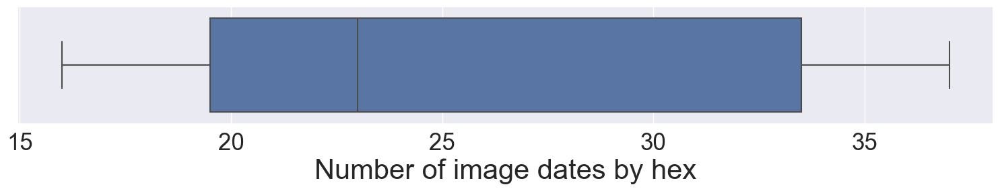

In [8]:
if visualization_level > 2:
    sns.set(rc={'figure.figsize':(18.7,2.27)})

    temporal_samples_count = df_positive.groupby(['hex'])['hex'].count()

    print('There are hexes with temporal samples from', temporal_samples_count.min(), 'to', temporal_samples_count.max())

    hist = pd.DataFrame(temporal_samples_count) \
            .rename(columns={'hex': 'count'}) \
            .reset_index(level=0) \
            .groupby(['count'])['count'].count()

    hist_df = pd.DataFrame(hist) \
              .rename(columns={'count': 'frequency'}) \
              .reset_index(level=0)

    #so.Plot(hist_df["count"], hist_df["frequency"]) \
    #    .add(so.Bar()) \
    #    .scale(x=so.Continuous().tick(every=2)) \
    #    .layout(size=(10, 4))

    ax = sns.boxplot(x=hist_df["count"])

    ax.set_xlabel("Number of image dates by hex",fontsize=30)
    ax.tick_params(labelsize=25)

## Sentinel 2 bands
These are the 12 bands contained in the parque files and their respective meanings

<div>
<img src="../res/sentinel2-bands.png" width="500"/>
</div>

## 1.5 Show some of the L12 hexes loaded in the folium map

In [9]:
if train_only_on_accurate_samples:
    # Drop hexes from non-conclusive areas
    drop_list = np.loadtxt('drop_list.csv', delimiter=',', dtype='str')

    df_negative = df_negative[~df_negative['hex'].isin(drop_list)]
    df_positive = df_positive[~df_positive['hex'].isin(drop_list)]
    
    # Treat false negatives
    false_negatives = np.loadtxt('false_negatives.csv', delimiter=',', dtype='str')

    df_negative = df_negative.assign(label=0)
    df_positive = df_positive.assign(label=1)
    
    df_negative = df_negative.reset_index()
    df_positive = df_positive.reset_index()
    
    # Assign to negatives recognized as false the label 1
    df_negative.loc[df_negative['hex'].isin(false_negatives), 'label'] = 1

    df_positive = pd.concat([df_positive, df_negative[df_negative.label==1]])
    
    df_negative = df_negative.drop(df_negative[df_negative.label == 1].index)
    print('Training dataset on manually curated samples.')

Training dataset on manually curated samples.


In [10]:
if generate_paper_info:
    for index, f in enumerate(df_positive.FIELD_OPERATION_GUID.unique()):
        print('F{:02d}'.format(index+1) +
              '&'+
              f'{df_positive[df_positive.FIELD_OPERATION_GUID == f].hex.nunique():,}' +
              '&'+
              f'{df_negative[df_negative.FIELD_OPERATION_GUID == f].hex.nunique()}' +
              '&'+
              f'{df_positive[df_positive.FIELD_OPERATION_GUID == f].hex.count():,}' +
              '&'+
              f'{df_negative[df_negative.FIELD_OPERATION_GUID == f].hex.count():,}' +
              '&'+
              '{:.2f}'.format(df_positive[df_positive.FIELD_OPERATION_GUID == f].groupby("hex").hex.count().mean()) +
              '&'+
              '{:.2f}'.format(df_positive[df_positive.FIELD_OPERATION_GUID == f].groupby("hex").hex.count().std()) +
              '\\\\'
             )


F01&558&210&9,860&3,539&17.67&0.48\\
F02&734&151&14,242&2,863&19.40&0.74\\
F03&59&85&1,075&1,528&18.22&0.65\\
F04&350&150&8,326&3,518&23.79&0.48\\
F05&75&134&1,815&3,001&24.20&0.90\\
F06&288&60&4,999&1,044&17.36&0.68\\
F07&418&140&9,409&2,950&22.51&0.70\\
F08&425&154&8,584&3,084&20.20&0.82\\
F09&147&127&2,993&2,563&20.36&0.71\\
F10&369&176&6,973&3,194&18.90&0.40\\
F11&228&57&4,813&1,172&21.11&0.59\\
F12&91&96&1,701&1,738&18.69&0.53\\
F13&151&86&3,271&1,840&21.66&0.49\\
F14&275&216&4,871&3,825&17.71&0.46\\
F15&370&198&7,369&3,913&19.92&0.66\\
F16&271&25&5,030&413&18.56&0.69\\
F17&281&17&5,099&297&18.15&0.97\\


## 1.6 Display hexes in the map

In [11]:
import io
from PIL import Image

def display_hexes_map(df, hexes_to_print=50000, filename=None):

    h3_hex = h3.h3_to_parent(df.iloc[0]['hex'], 3)

    df = df.drop_duplicates(subset='hex', keep="first").head(hexes_to_print)
    
    min_lat, min_long = 9999999,9999999
    max_lat, max_long = -9999999,-9999999
    
    
    for h in df.hex:
        p = h3.h3_to_geo(h)
        
        if p[0] < min_lat:
            min_lat = p[0]
            
        if p[0] > max_lat:
            max_lat = p[0]
            
        if p[1] < min_long:
            min_long = p[1]
            
        if p[1] > max_long:
            max_long = p[1]
            
    bounds = [[min_lat, min_long], [max_lat, max_long]]
    print(bounds)

    m = folium.Map(
                    tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                    attr = 'Esri',
                    name = 'Esri Satellite',
                    zoom_start=11,
                    fit_bounds=[[-97.7198928194847,26.236073089251086],[-97.66473848550342,26.243580591892144]],
                    overlay = False,
                    control = True)

    # Print h3 hex
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=h3_hex,geo_json=True)]}
    geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'white', 'color': 'white', 'weight': 0.5})
    geo_j.add_to(m)

    # Print positive samples
    for index, row in df.iterrows():
        geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
        if row['label'] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'yellow', 'color': 'green', 'weight': 0.5})
        elif row['label'] == 0:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'black', 'weight': 0.5})
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
        folium.Popup(str(row['FIELD_OPERATION_GUID']) + ' ' + str(row['hex'])).add_to(geo_j)
        geo_j.add_to(m)


    m.fit_bounds(bounds)
    
    display(m)
    
    if filename is not None:
        img_data = m._to_png(5)
        img = Image.open(io.BytesIO(img_data))
        img.save(filename)

# 1.7 Visualize the samples in the space reduced to 2 dimensions

In [12]:
def generate_samples_season(dfp, dfn):

    # Associate labels picked manually
    dfn = dfn.assign(label=0)
    dfp = dfp.assign(label=1)
    df = pd.concat([dfp, dfn], axis=0)

    df = df.reset_index()

    df['datetime'] = pd.to_datetime(df['timestamp'], format="%Y%m%dT%H%M%S")

    print('Number of total rows:' +  str(len(df.index)))
    print('Number of rows in positive dataset:' +  str(len(dfp.index)))
    print('Number of rows in negative dataset:' +  str(len(dfp.index)))
    print('Number of unique positive hexes:' +  str(dfp.hex.nunique()))
    print('Number of unique negative hexes:' +  str(dfn.hex.nunique()))


    df[band_features] = StandardScaler().fit_transform(df[band_features])

    # Organize the 2D samples in numpy arrays
    band_values_tmp = np.zeros((temporal_samples*10, number_of_bands), dtype=np.float64)
    X_array = np.empty((0, temporal_samples, number_of_bands),  dtype=np.float64)

    labels = []
    hexes = []
    fop = []
    timestamp_tracking = []
    timestamp_sample = []

    sub_index = 0
    count = 0;
    display(df.shape)

    
    for h in df.hex.unique():
        pct_complete = count/df.hex.nunique() * 100
        print('Sampling {0:.2f}'.format(pct_complete) + '%', end='\r')
        count = count + 1
        
        hexdf = df[df.hex == h]
        
        #display(hexdf)
        
        for index, row in hexdf.iterrows():
            # fill the band values in a temporal row
            for idx,b in enumerate(band_features):
                band_values_tmp[sub_index][idx] = row[b]    

            timestamp_sample.append(row.timestamp)

            # increment row number 
            sub_index = sub_index + 1


        try:
            debug = 'winter'
            timestamp_sample_aux = []
            winter_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 1 and int(s[4:6]) <= 3]
            winter_samples = np.random.choice(winter_samples, size=4)
            winter_array = np.array(band_values_tmp)[winter_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in winter_samples])

            debug = 'spring'
            spring_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 4 and int(s[4:6]) <= 6]
            spring_samples = np.random.choice(spring_samples, size=4)
            spring_array = np.array(band_values_tmp)[spring_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in spring_samples])

            debug = 'summer'
            summer_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 7 and int(s[4:6]) <= 9]
            summer_samples = np.random.choice(summer_samples, size=4)
            summer_array = np.array(band_values_tmp)[summer_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in summer_samples])

            debug = 'fall'
            fall_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 10 and int(s[4:6]) <= 12]
            fall_samples = np.random.choice(fall_samples, size=4)
            fall_array = np.array(band_values_tmp)[fall_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in fall_samples])

            timestamp_sample = timestamp_sample_aux

            sample = np.concatenate((winter_array, spring_array, summer_array, fall_array), axis=0)
        except Exception as e:
            print(debug, str(e))
            pass

        X_array = np.append(X_array, [sample], axis=0)
        labels.append(row.label)
        hexes.append(row.hex)
        fop.append(row.FIELD_OPERATION_GUID)
        timestamp_tracking.append(timestamp_sample.copy())            

        timestamp_sample.clear()
        sub_index = 0


    sorted_indices = np.argsort(hexes)
    hexes = np.array(hexes)[sorted_indices]
    labels = np.array(labels)[sorted_indices]
    X_array = X_array[sorted_indices]
    fop = np.array(fop)[sorted_indices]
    timestamp_tracking = np.array(timestamp_tracking)[sorted_indices]
    df = df.sort_values(by=['hex'])

    return df, X_array, labels, hexes, fop, timestamp_tracking


def generate_samples_shuffle(dfp, dfn):
    dfp = dfp.sort_values(by=['hex'])
    dfp = dfp.groupby('hex').head(temporal_samples)

    dfn = dfn.sort_values(by=['hex'])
    dfn = dfn.groupby('hex').head(temporal_samples)
    
    # Associate labels picked manually
    dfn = dfn.assign(label=0)
    dfp = dfp.assign(label=1)
    df = pd.concat([dfp, dfn], axis=0)

    df = df.reset_index()

    df[band_features] = StandardScaler().fit_transform(df[band_features])

    # Organize the 2D samples in numpy arrays
    sample = np.zeros((temporal_samples, number_of_bands), dtype=np.float64)
    X_array = np.empty((0, temporal_samples, number_of_bands),  dtype=np.float64)

    labels = []
    hexes = []
    fop = []
    timestamp_tracking = []
    timestamp_sample = []

    sub_index = 0
    count = 0;
    
    for index, row in df.iterrows():
        pct_complete = count/df.shape[0] * 100
        print('Sampling {0:.2f}'.format(pct_complete) + '%', end='\r')
        count = count + 1

        # fill the band values in a temporal row
        for idx,b in enumerate(band_features):
            sample[sub_index][idx] = row[b]

        timestamp_sample.append(row.timestamp)

        # increment row number 
        sub_index = sub_index + 1

        # if reached last row of temporal samples, increment to next sample
        if sub_index == temporal_samples:
            shuffler = np.random.permutation(sample.shape[0])
            sample = sample[shuffler]
            timestamp_sample = list(np.array(timestamp_sample)[shuffler])
                
            X_array = np.append(X_array, [sample], axis=0)
            labels.append(row.label)
            hexes.append(row.hex)
            fop.append(row.FIELD_OPERATION_GUID)
            timestamp_tracking.append(timestamp_sample.copy())            

            timestamp_sample.clear()
            sub_index = 0
            
    sorted_indices = np.argsort(hexes)
    hexes = np.array(hexes)[sorted_indices]
    labels = np.array(labels)[sorted_indices]
    X_array = X_array[sorted_indices]
    fop = np.array(fop)[sorted_indices]
    timestamp_tracking = np.array(timestamp_tracking)[sorted_indices]
    df = df.sort_values(by=['hex'])
    
    return df, X_array, labels, hexes, fop, timestamp_tracking


if sampling_method == 'season':
    df, X_array, labels, hexes, fop, timestamp_tracking = generate_samples_season(df_positive, df_negative)
elif sampling_method == 'shuffle':
    df, X_array, labels, hexes, fop, timestamp_tracking = generate_samples_shuffle(df_positive, df_negative)
else:
    raise Exception('You need to select a sampling method')
    
print(X_array.shape)
print(len(labels))
print(len(hexes))

Number of total rows:140912
Number of rows in positive dataset:100430
Number of rows in negative dataset:100430
Number of unique positive hexes:5066
Number of unique negative hexes:2050


(140912, 24)

(7116, 16, 12)%
7116
7116


In [13]:
df_total = df.groupby(['FIELD_OPERATION_GUID'])['FIELD_OPERATION_GUID'].count()
df_unique = df.groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()

df_nunique = df[df.label==0].groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()
df_punique = df[df.label==1].groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()

df_ncount = df[df.label==0].groupby(['FIELD_OPERATION_GUID'])['hex'].count()
df_pcount = df[df.label==1].groupby(['FIELD_OPERATION_GUID'])['hex'].count()

for i in range(0,17):
    print('F{:02d}&'.format(i+1) + '{:,}'.format(df_total[i]) + '&' + '{:,}'.format(df_pcount[i]) + '&' + 
          '{:,}'.format(df_ncount[i]) + '&' + '{:,}'.format(df_punique[i]) + '&' + '{:,}'.format(df_nunique[i]) +
          '&' + '{:.2f}'.format(df_total[i]/df_unique[i]) + '\\\\')

F01&5,443&5,030&413&271&25&18.39\\
F02&13,399&9,860&3,539&558&210&17.45\\
F03&17,105&14,242&2,863&734&151&19.33\\
F04&5,111&3,271&1,840&151&86&21.57\\
F05&2,603&1,075&1,528&59&85&18.08\\
F06&11,844&8,326&3,518&350&150&23.69\\
F07&8,696&4,871&3,825&275&216&17.71\\
F08&4,816&1,815&3,001&75&134&23.04\\
F09&6,043&4,999&1,044&288&60&17.36\\
F10&11,282&7,369&3,913&370&198&19.86\\
F11&5,396&5,099&297&281&17&18.11\\
F12&12,359&9,409&2,950&418&140&22.15\\
F13&11,668&8,584&3,084&425&154&20.15\\
F14&5,556&2,993&2,563&147&127&20.28\\
F15&10,167&6,973&3,194&369&176&18.66\\
F16&5,985&4,813&1,172&228&57&21.00\\
F17&3,439&1,701&1,738&91&96&18.39\\


## 1.8 TSNE Visualization BEFORE encoding

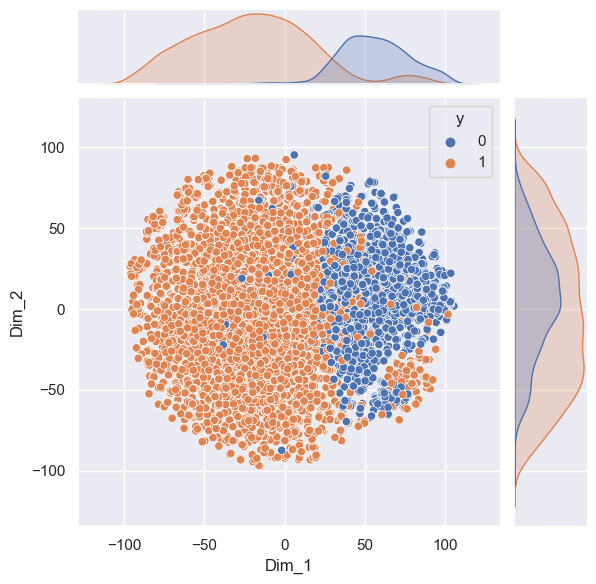

In [14]:
from sklearn.manifold import TSNE
import seaborn as sns
import warnings

if visualization_level > 2:
    warnings.filterwarnings('ignore')
    model = TSNE(n_components=2, perplexity=4, random_state=0)
    tsne_data = model.fit_transform(X_array.reshape(X_array.shape[0], number_of_bands * temporal_samples))
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2"))
    tsne_data = pd.concat([tsne_df, pd.DataFrame(labels, columns=['y'])], axis=1)
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2", "y"))

    sns.jointplot(data=tsne_df, x="Dim_1", y="Dim_2", hue='y')
    plt.show()
    warnings.filterwarnings('default')

## 1.9 Sample visualization

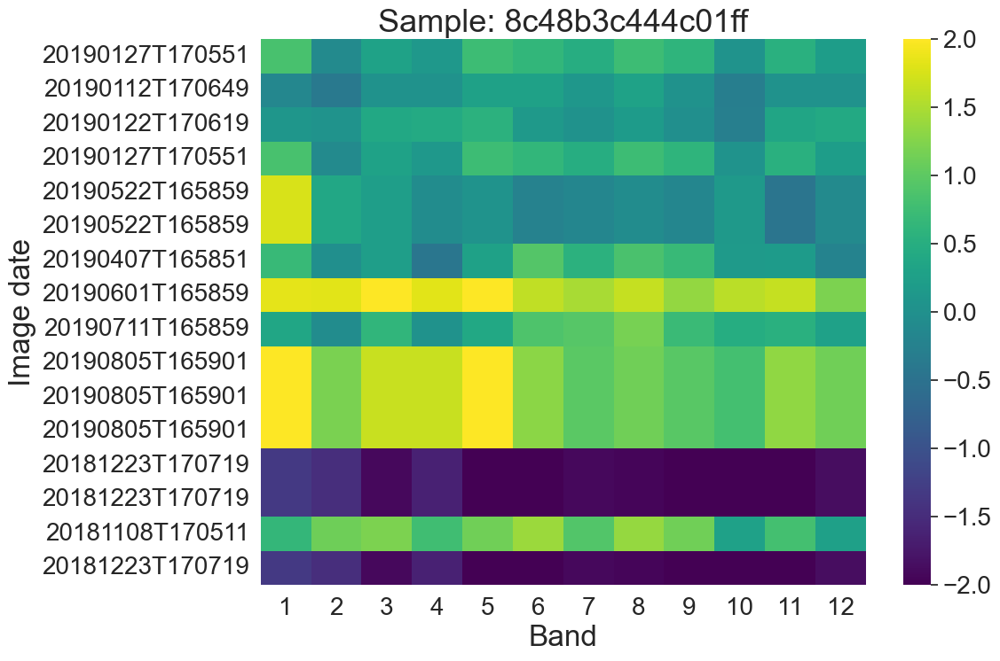

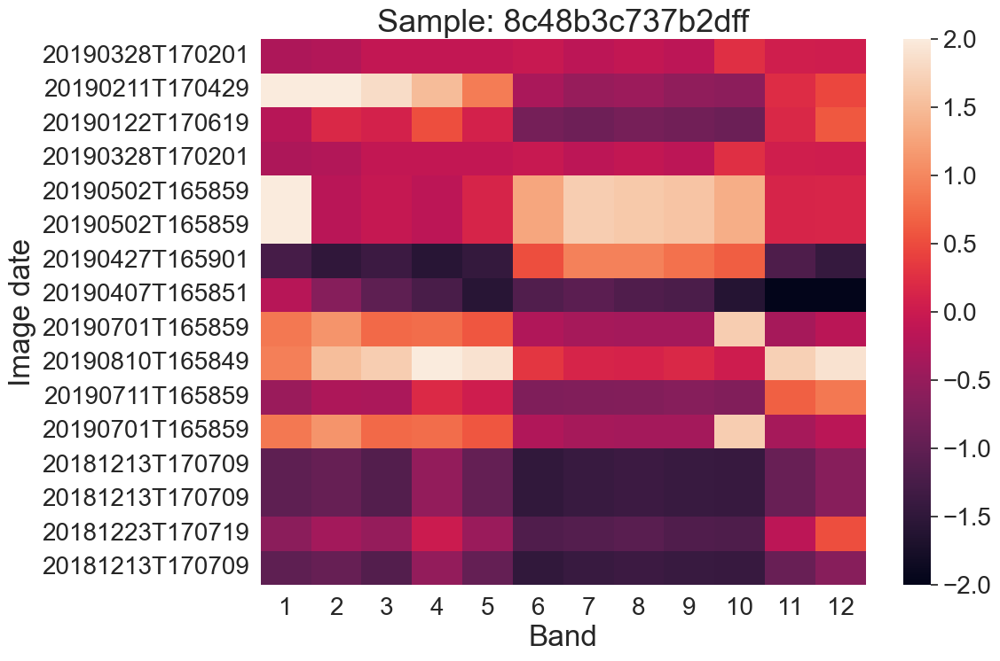

In [15]:
if visualization_level > 2:
    sns.set(rc={'figure.figsize':(11,8)})

    for i in range(0,1):
        # This is what a positive sample looks like
        xticklabels = range(1,13)
        yticklabels = range(1,16)
        yticklabels = timestamp_tracking[i]
        ax = sns.heatmap(X_array[i], annot=False, cmap="viridis", vmin=-2, vmax=2, 
                         xticklabels=xticklabels, yticklabels=yticklabels, 
                         fmt='g', annot_kws={"fontsize":24}, cbar=True)
        ax.set_xlabel("Band",fontsize=24)
        ax.set_ylabel("Image date",fontsize=24)
        ax.set_title('Sample: ' + hexes[i], fontsize=26)
        ax.tick_params(labelsize=20)

        cbar = ax.collections[0].colorbar
        cbar.ax.tick_params(labelsize=20)
        plt.show()



    for i in range(-2,-1):
        xticklabels = range(1,13)
        yticklabels = range(1,16)
        yticklabels = timestamp_tracking[i]
        ax = sns.heatmap(X_array[i], annot=False, cmap="rocket", vmin=-2, vmax=2, 
                         xticklabels=xticklabels, yticklabels=yticklabels, 
                         fmt='g', annot_kws={"fontsize":20}, cbar=True)
        ax.set_xlabel("Band",fontsize=24)
        ax.set_ylabel("Image date",fontsize=24)
        ax.set_title('Sample: ' + hexes[i], fontsize=26)
        ax.tick_params(labelsize=20)

        cbar = ax.collections[0].colorbar
        cbar.ax.tick_params(labelsize=20)
        plt.show()

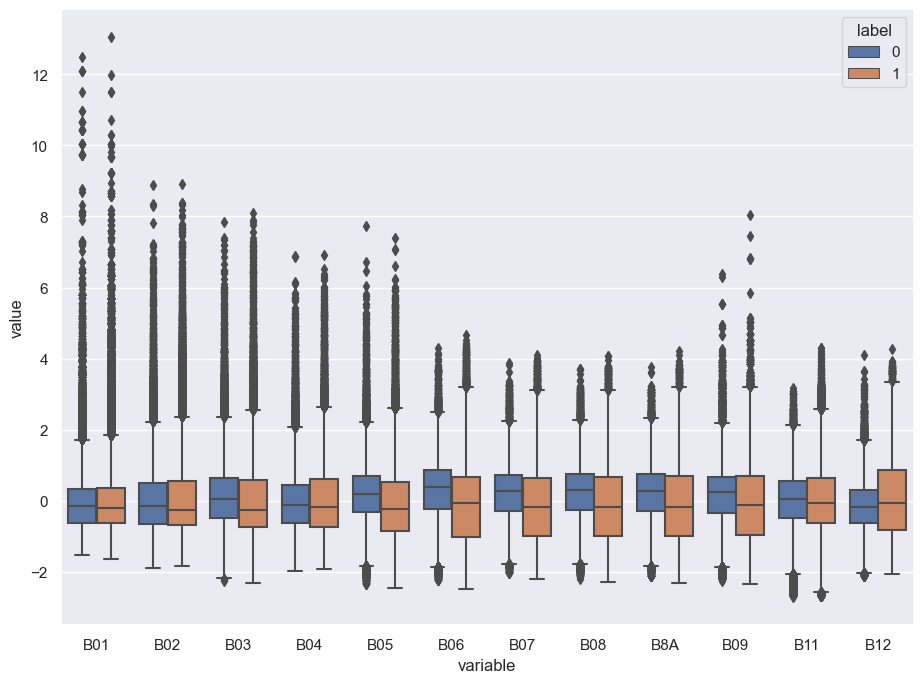

In [16]:
import pandas as pd
import seaborn as sns

if visualization_level > 2:
    value_vars = [i for i in df.columns if i.startswith('B')]
    id_vars = ['label']
    data = pd.melt(df, id_vars=id_vars, value_vars=value_vars)

    sns.set(rc={'figure.figsize':(11,8)})
    sns.boxplot(x="variable", y="value", hue='label', data=data)

# 1.10 Check correlation among bands

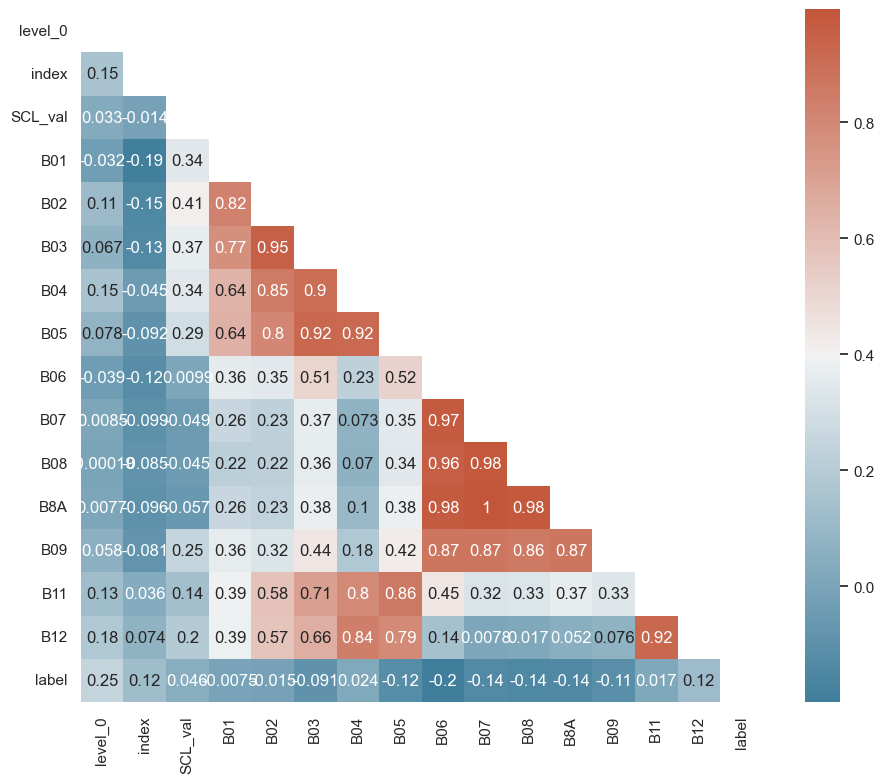

In [17]:
if visualization_level > 2:
    sns.set_theme(style="white")
    # Compute the correlation matrix
    corr = df.corr()

    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=(11, 9))

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    sns.heatmap(corr,mask=mask,cmap=cmap, annot=True )

<a id='model_training'></a>

# 2. Triplet Siamese Loss Model Training

## 2.1 Prepare the Dataset for Training

In [18]:
print('Total of samples:', X_array.shape)

def prepare_training_dataset(test_index, val_index):
#    labels_and_hexes = np.vstack((hexes, labels)).T

    # Test dataset is the field we picked to test
#    X_test = X_array[test_index]
#    labels_test = np.array(labels)[test_index]
#    hexes_test = np.array(hexes)[test_index]
#    y_test = np.array(labels)[test_index]

#    X_val = X_array[val_index]
#    labels_val = np.array(labels)[val_index]
#    hexes_val = np.array(hexes)[val_index]
#    y_val = np.array(labels)[val_index]

    # Train dataset is every but the test field
    X_train = X_array[~(test_index+val_index )]
    labels_train = np.array(labels)[~(test_index+val_index)]
    hexes_train = np.array(hexes)[~(test_index+val_index)]

    # Negative train
    X_array_n = X_train[np.array(labels_train) == 0]
    # Positive train
    X_array_p = X_train[np.array(labels_train) == 1]

    # Anchors are half of the positive train
    X_array_anchors = X_array_p[0:math.floor((X_array_p.shape[0]/2))]
    # Positives are the other half of the positive train
    X_array_positives = X_array_p[math.floor(X_array_p.shape[0]/2):-1]
    # Negatives are half of the negative train samples
    X_array_negatives = X_array_n[0:math.floor((X_array_p.shape[0]/2))]

    print('Total of anchors samples:', X_array_anchors.shape)
    print('Total of positive samples:', X_array_positives.shape)
    print('Total of negative samples:', X_array_negatives.shape)

    samples_count = X_array_anchors.shape[0]
    print('Number of samples:', samples_count)
    
    anchor_dataset = tf.data.Dataset\
        .from_tensor_slices(X_array_anchors)

    positive_dataset = tf.data.Dataset\
        .from_tensor_slices(X_array_positives)
    
    negative_dataset = tf.data.Dataset\
        .from_tensor_slices(X_array_negatives)
    
    dataset = tf.data.Dataset.zip((anchor_dataset, positive_dataset, negative_dataset))
    dataset = dataset.shuffle(buffer_size=128)

    # Let's now split our dataset in train and validation.
    train_dataset = dataset.take(round(samples_count * 0.8))
    val_dataset = dataset.skip(round(samples_count * 0.8))

    train_dataset = train_dataset.batch(32, drop_remainder=False)
    #train_dataset = train_dataset.prefetch(8)

    val_dataset = val_dataset.batch(32, drop_remainder=False)
    #val_dataset = val_dataset.prefetch(8)

    return train_dataset, val_dataset

field_index = 0
test_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index]
val_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index+1]
test_index = np.array(fop) == test_field
val_index = np.array(fop) == val_field

train_dataset, val_dataset = prepare_training_dataset(test_index, val_index)

Total of samples: (7116, 16, 12)
Total of anchors samples: (1887, 16, 12)
Total of positive samples: (1886, 16, 12)
Total of negative samples: (1689, 16, 12)
Number of samples: 1887


In [19]:
def prepare_validation_dataset(test_index, val_index):

    X_test = X_array[test_index]
    hexes_test = hexes[test_index]
    y_test = labels[test_index]
    fop_test = fop[test_index]

    X_val = X_array[val_index]
    hexes_val = hexes[val_index]
    y_val = labels[val_index]
    fop_val = fop[val_index]

    X_train = X_array[~(test_index+val_index)]
    hexes_train = hexes[~(test_index+val_index)]
    y_train = labels[~(test_index+val_index)]
    
    print(X_train.shape, y_train.shape)
    
    labeled_train_samples = X_train.shape[0]
    
    y_train = y_train.astype(np.int)
    #y_test_ft = y_test_ft.astype(np.int)
    #y_val_ft = y_val_ft.astype(np.int)

    #print('Total of training samples:',X_train_ft.shape, len(y_train_ft))
    #print('Total of test samples:', X_test_ft.shape, len(y_test_ft))
    #print('Total of validation samples:', X_val_ft.shape, len(y_val_ft))
    
    labeled_batch_size = labeled_train_samples
    batch_size = labeled_batch_size

    train_dataset = tf.data.Dataset\
        .from_tensor_slices((X_train, y_train))\
        .shuffle(buffer_size=10 * labeled_batch_size)\
        .batch(labeled_batch_size, drop_remainder=True)

    test_dataset = tf.data.Dataset\
        .from_tensor_slices((X_test))\
        .batch(batch_size)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)

    validation_dataset = tf.data.Dataset\
        .from_tensor_slices((X_val, y_val))\
        .batch(batch_size)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)


    return batch_size, train_dataset, test_dataset, validation_dataset, y_test, hexes_test, fop_test

Total of anchors samples: (1887, 16, 12)
Total of positive samples: (1886, 16, 12)
Total of negative samples: (1689, 16, 12)
Number of samples: 1887


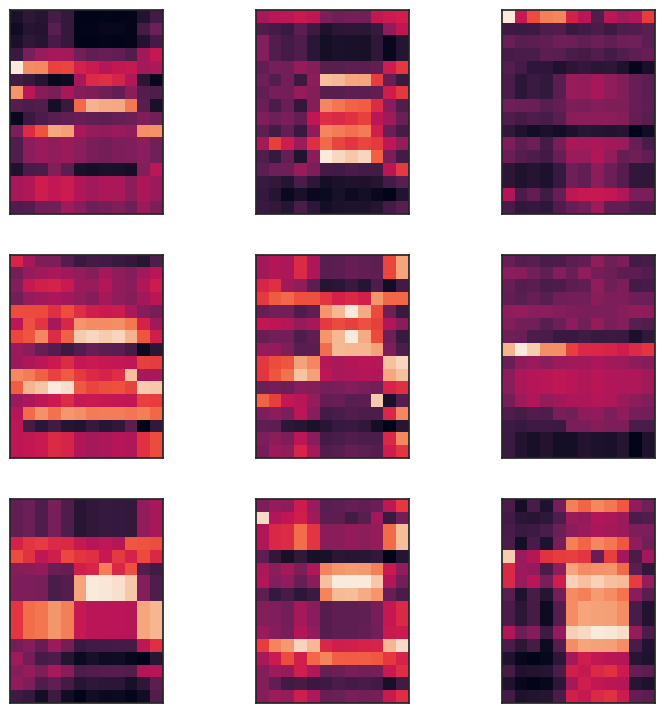

In [20]:
def visualize(anchor, positive, negative):
    """Visualize a few triplets from the supplied batches."""

    def show(ax, image):
        ax.imshow(image)
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    fig = plt.figure(figsize=(9, 9))

    axs = fig.subplots(3, 3)
    for i in range(3):
        show(axs[i, 0], anchor[i])
        show(axs[i, 1], positive[i])
        show(axs[i, 2], negative[i])

field_index = 0
test_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index]
val_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index+1]

test_index = np.array(fop) == test_field
val_index = np.array(fop) == val_field

if visualization_level > 2:
    train_dataset, val_dataset = prepare_training_dataset(test_index, val_index)
    visualize(*list(train_dataset.take(1).as_numpy_iterator())[0])

## Triplet Loss Siamese Model

In [21]:
from tensorflow.keras import Model

# Define the encoder architecture
def get_encoder():
    return keras.Sequential(
        [
            keras.Input(shape=(temporal_samples, number_of_bands)),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Flatten(),
            layers.Dense(width, activation="relu"),
        ],
        name="encoder",
    )

class DistanceLayer(layers.Layer):
    """
    This layer is responsible for computing the distance between the anchor
    embedding and the positive embedding, and the anchor embedding and the
    negative embedding.
    """

    def __init__(self, **kwargs):
        super().__init__(**kwargs)

    def call(self, anchor, positive, negative):
        
        if loss_function_distance == 'euclidean':
            ap_distance = tf.reduce_sum(tf.square(anchor - positive), -1)
            an_distance = tf.reduce_sum(tf.square(anchor - negative), -1)
        elif loss_function_distance == 'cosine':
             # Normalize the embeddings
            anchor = tf.nn.l2_normalize(anchor, axis=-1)
            positive = tf.nn.l2_normalize(positive, axis=-1)
            negative = tf.nn.l2_normalize(negative, axis=-1)

            # Compute cosine similarities
            ap_distance = 1.0 - tf.reduce_sum(anchor * positive, axis=-1, keepdims=True)
            an_distance = 1.0 - tf.reduce_sum(anchor * negative, axis=-1, keepdims=True)
        else:
            raise Exception('You must set a distance metric for the loss function')
        
        return (ap_distance, an_distance)

anchor_input = layers.Input(name="anchor", shape=(temporal_samples,number_of_bands))
positive_input = layers.Input(name="positive", shape=(temporal_samples,number_of_bands))
negative_input = layers.Input(name="negative", shape=(temporal_samples,number_of_bands))

class SiameseModel(Model):
    """The Siamese Network model with a custom training and testing loops.

    Computes the triplet loss using the three embeddings produced by the
    Siamese Network.

    The triplet loss is defined as:
       L(A, P, N) = max(‖f(A) - f(P)‖² - ‖f(A) - f(N)‖² + margin, 0)
    """

    def __init__(self, siamese_network, margin=0.5):
        super().__init__()
        self.siamese_network = siamese_network
        self.margin = margin
        self.loss_tracker = keras.metrics.Mean(name="loss")

    def call(self, inputs):
        return self.siamese_network(inputs)

    def train_step(self, data):
        # GradientTape is a context manager that records every operation that
        # you do inside. We are using it here to compute the loss so we can get
        # the gradients and apply them using the optimizer specified in
        # `compile()`.
        with tf.GradientTape() as tape:
            loss = self._compute_loss(data)

        # Storing the gradients of the loss function with respect to the
        # weights/parameters.
        gradients = tape.gradient(loss, self.siamese_network.trainable_weights)

        # Applying the gradients on the model using the specified optimizer
        self.optimizer.apply_gradients(
            zip(gradients, self.siamese_network.trainable_weights)
        )

        # Let's update and return the training loss metric.
        self.loss_tracker.update_state(loss)
        return {"loss": self.loss_tracker.result()}

    def test_step(self, data):
        loss = self._compute_loss(data)

        # Let's update and return the loss metric.
        self.loss_tracker.update_state(loss)
        return {"loss": self.loss_tracker.result()}

    def _compute_loss(self, data):
        # The output of the network is a tuple containing the distances
        # between the anchor and the positive example, and the anchor and
        # the negative example.
        ap_distance, an_distance = self.siamese_network(data)

        # Computing the Triplet Loss by subtracting both distances and
        # making sure we don't get a negative value.
        loss = ap_distance - an_distance
        loss = tf.maximum(loss + self.margin, 0.0)
        return loss

    @property
    def metrics(self):
        # We need to list our metrics here so the `reset_states()` can be
        # called automatically.
        return [self.loss_tracker]


<a id='report'></a>

# 3. Report Generation

In [22]:
# Test report
for i in range(0,len(df_positive.FIELD_OPERATION_GUID.unique())):
    
    tid = str(uuid.uuid4()).split('-')[0]
    
    field_index = i
    test_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index]
    
    if field_index == (df_positive.FIELD_OPERATION_GUID.nunique()-1):
        val_field = df_positive.FIELD_OPERATION_GUID.unique()[0]
        description = 'Training with test on field ' + str(i) + ' and validation on field ' + '0' + ' and test identifier ' + tid
    else:    
        val_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index+1]
        description = 'Training with test on field ' + str(i) + ' and validation on field ' + str(i+1) + ' and test identifier ' + tid
            
    print('Test Field = ', test_field)
    print('Validation Field = ', val_field)
    
    test_index = np.array(fop) == test_field
    val_index = np.array(fop) == val_field
    print('The test field has number of hexes equals to ', sum(test_index))
    
    train_dataset, val_dataset = prepare_training_dataset(test_index, val_index)
    
    embedding = get_encoder()
    
    distances = DistanceLayer()(
        embedding(anchor_input),
        embedding(positive_input),
        embedding(negative_input),
    )
    
    siamese_network = Model(
        inputs=[anchor_input, positive_input, negative_input], outputs=distances
    )
        
    siamese_model = SiameseModel(siamese_network)
    siamese_model.compile(optimizer=keras.optimizers.Adam(0.0001), run_eagerly = False)
    siamese_model.fit(train_dataset, epochs=num_epochs, validation_data=val_dataset)
    
    
    batch_size_ft, train_dataset_ft, test_dataset_ft, validation_dataset_ft, y_test_ft, hexes_test_ft, fop_test_ft = prepare_validation_dataset(test_index, val_index)

#------------------------------------------------------------------------------------------
    
    # Supervised finetuning of the pretrained encoder
    finetuning_model = keras.Sequential(
        [
            layers.Input(shape=(temporal_samples, number_of_bands)),
            embedding,
            layers.Dense(1, activation='sigmoid'),
        ],
        name="finetuning_model",
    )
    finetuning_model.compile(
        optimizer=keras.optimizers.Adam(),
        loss=keras.losses.BinaryCrossentropy(from_logits=False),
        metrics=[keras.metrics.BinaryAccuracy(name="acc")],
    )

    print(train_dataset_ft)
    print(validation_dataset_ft)
    finetuning_history = finetuning_model.fit(
        train_dataset_ft, epochs=num_epochs, validation_data=validation_dataset_ft
    )
    print(
        "Maximal validation accuracy: {:.2f}%".format(
            max(finetuning_history.history["val_acc"]) * 100
        )
    )

    #------------------------------------------------------------------------------------------

    from sklearn.metrics import accuracy_score, recall_score, precision_score,f1_score,confusion_matrix,matthews_corrcoef

    print(
        "Finetuning maximal validation accuracy: {:.2f}%".format(
            max(finetuning_history.history["val_acc"]) * 100
        )
    )

    print('---------------')

    output = finetuning_model.predict(test_dataset_ft)
    result = np.where(output > 0.5, 1, 0)

    test_ft_df = pd.concat([
                            pd.DataFrame(y_test_ft, columns=['label']),
                            pd.DataFrame(hexes_test_ft, columns=["hex"]), 
                            pd.DataFrame(fop_test_ft, columns=["FIELD_OPERATION_GUID"])
                          ], axis=1)


    display_hexes_map(test_ft_df, filename=folder + 'test_actual_' + tid + '.png')

    print('Triplet Loss Accuracy: {:.2f}%'.format(accuracy_score(y_test_ft, result) * 100))
    print('Triplet Loss Recall: {:.2f}%'.format(recall_score(y_test_ft, result) * 100))
    print('Triplet Loss Precision: {:.2f}%'.format(precision_score(y_test_ft, result) * 100))
    print('Triplet Loss F1: {:.2f}%'.format(f1_score(y_test_ft, result) * 100))
    m = confusion_matrix(y_test_ft, result)
    print('Triplet Loss Acc by Class', (m.diagonal()/m.sum(axis=1)))
    print('Triplet Loss MCC:', matthews_corrcoef(y_test_ft, result))

    print(
          '%.2f' % (float(accuracy_score(y_test_ft, result))*100) + '\\%&',
          '%.2f' % float(f1_score(y_test_ft, result, average='weighted')*100)+ '\\%&',
          '%.2f' % float(f1_score(y_test_ft, result, average=None)[0]*100)+ '\\%&',
          '%.2f' % float(f1_score(y_test_ft, result, average=None)[1]*100)+ '\\%&',
          '%.2f' % matthews_corrcoef(y_test_ft, result) + '\\\\',
         )

    print(confusion_matrix(y_test_ft, result))
    confusion_matrix(y_test_ft, result)
    accuracy_list = (y_test_ft==result.T[0])


    #------------------------------------------------------------------------------------------

    df_classes_ft = pd.DataFrame(result, columns=['label'])
    df_hexes_ft = pd.DataFrame(hexes_test_ft, columns=['hex'])
    df_fop_ft = pd.DataFrame(fop_test_ft, columns=['FIELD_OPERATION_GUID'])

    df_predict_ft = pd.concat([df_hexes_ft,df_classes_ft,df_fop_ft], axis=1)

    display_hexes_map(df_predict_ft, filename=folder + 'test_predicted_' + tid + '.png')
    

    # Test report

    javascript = '<script> \
    function sortTable(n) { \
      var table, rows, switching, i, x, y, shouldSwitch, dir, switchcount = 0; \
      table = document.getElementById("myTable"); \
      switching = true; \
      dir = "asc"; \
      while (switching) { \
        switching = false; \
        rows = table.rows; \
        for (i = 2; i < (rows.length - 1); i++) { \
          shouldSwitch = false; \
          x = rows[i].getElementsByTagName("TD")[n]; \
          y = rows[i + 1].getElementsByTagName("TD")[n]; \
          if (dir == "asc") { \
            if (x.innerHTML.toLowerCase() > y.innerHTML.toLowerCase()) { \
              shouldSwitch = true; \
              break; \
            } \
    } else if (dir == "desc") { \
    if (x.innerHTML.toLowerCase() < y.innerHTML.toLowerCase()) { \
    shouldSwitch = true; \
              break; \
            } \
          } \
        } \
        if (shouldSwitch) { \
          rows[i].parentNode.insertBefore(rows[i + 1], rows[i]); \
          switching = true; \
          switchcount ++; \
        } else { \
          if (switchcount == 0 && dir == "asc") { \
            dir = "desc"; \
            switching = true; \
          } \
        } \
      } \
    } \
    function myFunction() { \
      var input, filter, table, tr, td, i, txtValue; \
      input = document.getElementById("myInput"); \
      filter = input.value.toUpperCase(); \
      table = document.getElementById("myTable"); \
      tr = table.getElementsByTagName("tr"); \
      var cols = document.getElementById("myTable").rows[1].cells.length;\
      var displayLine = 0; \
      strs = filter.split("|"); \
      for (row = 2; row < tr.length; row++) { \
        for (s = 0; s < strs.length; s++) { \
          for (c = 0; c < cols; c++) { \
            td = tr[row].getElementsByTagName("td")[c]; \
            if (td) { \
              txtValue = td.textContent || td.innerText; \
              console.log(strs[s]); \
              if (txtValue.toUpperCase().indexOf(strs[s]) > -1) { \
                displayLine = displayLine + 1; \
              } else { \
                displayLine = displayLine; \
              } \
            } \
          } \
        } \
        if(displayLine >= (strs.length)) { \
            tr[row].style.display = ""; \
          } \
          else { \
            tr[row].style.display = "none"; \
          } \
          displayLine = 0; \
      } \
    }\
    function zoom(e){\n\
      var zoomer = e.currentTarget;\n\
      e.offsetX ? offsetX = e.offsetX : offsetX = e.touches[0].pageX\n\
      e.offsetY ? offsetY = e.offsetY : offsetX = e.touches[0].pageX\n\
      x = offsetX/zoomer.offsetWidth*100\n\
      y = offsetY/zoomer.offsetHeight*100\n\
      zoomer.style.backgroundPosition = x + "% " + y + "%";\n\
    }\n\
    </script>'

    style = '<style>\
    * {\
      box-sizing: border-box;\
    }\
    .tooltip {\
      position: relative;\
      display: inline-block;\
      border-bottom: 1px dotted black;\
    }\
    .tooltip .tooltiptext {\
      visibility: hidden;\
      width: 240px;\
      background-color: black;\
      color: #fff;\
      text-align: center;\
      border-radius: 6px;\
      padding: 5px 0;\
      position: absolute;\
      z-index: 1;\
    }\
    .tooltip:hover .tooltiptext {\
      visibility: visible;\
    }\
    #myInput {\
      background-image: url("/css/searchicon.png");\
      background-position: 10px 10px;\
      background-repeat: no-repeat;\
      width: 100%;\
      font-size: 16px;\
      padding: 12px 20px 12px 40px;\
      border: 1px solid #ddd;\
      margin-bottom: 12px;\
    }\
    #myTable {\
      border-collapse: collapse;\
      width: 100%;\
      border: 1px solid #ddd;\
      font-size: 18px;\
    }\
    #myTable th, #myTable td {\
      text-align: left;\
      padding: 12px;\
    }\
    #myTable tr {\
      border-bottom: 1px solid #ddd;\
    }\
    #myTable tr.header{\
      background-color: #f1f1f1;\
      cursor: pointer;\
    }\
    #myTable tr:hover {\
      background-color: #f1f1f1;\
    }\
    figure.zoom {\
      background-position: 50% 50%;\
      position: relative;\
      width: 450px;\
      overflow: hidden;\
      cursor: zoom-in;\
    }\
    figure.zoom img:hover {\
      opacity: 0;\
    }\
    figure.zoom img {\
      transition: opacity 0.5s;\
      display: block;\
      width: 100%;\
      height: 100%;\
    }\
    </style>'

    import sys

    try:
        with open(folder + 'report.html', 'r') as file:
            table = file.read()
    except:
        table = ''
        table = '<html><head>'
        table += javascript
        table += '<meta name="viewport" content="width=device-width, initial-scale=1">'
        table += style
        table += '</head><body><h2>Search</h2>'
        table += '<input type="text" id="myInput" onkeyup="myFunction()" placeholder="Search for names.." title="Type in a name">'
        table += '<table border=1 id="myTable">\n'
        # Create the table's column headers
        table += '<tr>\n'
        table += '<th colspan=6>Parameters</th>\n'
        table += '<th colspan=1>Validation Results</th>'
        table += '<th colspan=6>Test Results</th>'
        table += '</tr>\n'

        table += '<tr>\n'
        table += '<th href="javascript:void(0)" onclick="sortTable(0)"><div class="tooltip">Description<span class="tooltiptext">Experiment description</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(1)"><div class="tooltip">width<span class="tooltiptext">Width of encoded vector</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(2)"><div class="tooltip">margin<span class="tooltiptext">Margin of triplet siamese algorithm</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(3)"><div class="tooltip">loss function<span class="tooltiptext">Distance used in loss function</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(4)"><div class="tooltip">sampling method<span class="tooltiptext">Method to create the sample matrix</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(5)"><div class="tooltip">Bands<span class="tooltiptext">Sentinel-2 bands utilized</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(6)"><div class="tooltip">Accuracy<span class="tooltiptext">Validation accuracy</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(7)"><div class="tooltip">Accuracy<span class="tooltiptext">Test accuracy</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(8)"><div class="tooltip">F1<span class="tooltiptext">F1 weighted</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(9)"><div class="tooltip">MCC<span class="tooltiptext">Matthews Correlation Coeficient</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(10)"><div class="tooltip">Confusion Matrix<span class="tooltiptext">Confusion Matrix</span></div></th>'
        table += '<th>Actual</th>'
        table += '<th>Predicted</th>'
        table += '</tr>\n'
        print('No report file found')


    fileout = open(folder + "report.html", "w")

    table += '<tr>\n'
    table += f'<td>{description}</td><td>{width}</td><td>{siamese_margin}</td><td>{loss_function_distance}</td><td>{sampling_method}</td><td>{band_features}</td>'
    table += '<td>{:.2f}%</td>'.format(max(finetuning_history.history["val_acc"]) * 100)
    table += '<td>%.2f'  % (float(accuracy_score(y_test_ft, result))*100) + '% </td>'
    table += '<td>%.2f'  % float(f1_score(y_test_ft, result, average='weighted')*100) + '% </td>'
    table += '<td>%.2f' % matthews_corrcoef(y_test_ft, result)+ '</td>'
    table += '<td>' + str(m[0]) + '<br />' + str(m[1]) + '</td>'
    table += f'<td><figure class="zoom" onmousemove="zoom(event)" style="background-image: url(test_actual_{tid}.png)"> <img src="test_actual_{tid}.png" /> </figure></td>'
    table += f'<td><figure class="zoom" onmousemove="zoom(event)" style="background-image: url(test_predicted_{tid}.png)"> <img src="test_predicted_{tid}.png" /> </figure></td>'
    table += '</tr>\n'

    fileout.writelines(table)
    fileout.close()

Test Field =  1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24
Validation Field =  19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17
The test field has number of hexes equals to  768
Total of anchors samples: (1887, 16, 12)
Total of positive samples: (1886, 16, 12)
Total of negative samples: (1689, 16, 12)
Number of samples: 1887
Epoch 1/200
48/48 [==============================] - 1s 6ms/step - loss: 0.4924 - val_loss: 0.4840
Epoch 2/200
48/48 [==============================] - 0s 3ms/step - loss: 0.3602 - val_loss: 0.4225
Epoch 3/200
48/48 [==============================] - 0s 3ms/step - loss: 0.2468 - val_loss: 0.3647
Epoch 4/200
48/48 [==============================] - 0s 3ms/step - loss: 0.1975 - val_loss: 0.3233
Epoch 5/200
48/48 [==============================] - 0s 3ms/step - loss: 0.1585 - val_loss: 0.2436
Epoch 6/200
48/48 [==============================] - 0s 3ms/step - loss: 0.1318 - val_loss: 0.2163
Epoch 7/200
48/48 [==============================] - 0s 4ms/step - loss: 0.10

48/48 [==============================] - 0s 3ms/step - loss: 2.3800e-04 - val_loss: 0.0321
Epoch 79/200
48/48 [==============================] - 0s 3ms/step - loss: 0.0014 - val_loss: 0.0304
Epoch 80/200
48/48 [==============================] - 0s 3ms/step - loss: 1.3538e-04 - val_loss: 0.0290
Epoch 81/200
48/48 [==============================] - 0s 4ms/step - loss: 2.1021e-04 - val_loss: 0.0280
Epoch 82/200
48/48 [==============================] - 0s 3ms/step - loss: 1.3178e-05 - val_loss: 0.0268
Epoch 83/200
48/48 [==============================] - 0s 3ms/step - loss: 2.7305e-04 - val_loss: 0.0298
Epoch 84/200
48/48 [==============================] - 0s 3ms/step - loss: 8.1689e-05 - val_loss: 0.0291
Epoch 85/200
48/48 [==============================] - 0s 4ms/step - loss: 8.7333e-05 - val_loss: 0.0293
Epoch 86/200
48/48 [==============================] - 0s 3ms/step - loss: 8.1430e-05 - val_loss: 0.0277
Epoch 87/200
48/48 [==============================] - 0s 3ms/step - loss: 9.6824e

48/48 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 157/200
48/48 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 158/200
48/48 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 159/200
48/48 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 160/200
48/48 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 161/200
48/48 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 162/200
48/48 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 163/200
48/48 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 164/200
48/48 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0300
Epoch 165/200
48/48 [==============================] - 0s 3ms/step - 

1/1 [==============================] - 0s 55ms/step - loss: 0.0843 - acc: 0.9709 - val_loss: 0.1373 - val_acc: 0.9446
Epoch 27/200
1/1 [==============================] - 0s 61ms/step - loss: 0.0839 - acc: 0.9716 - val_loss: 0.1405 - val_acc: 0.9424
Epoch 28/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0831 - acc: 0.9722 - val_loss: 0.1357 - val_acc: 0.9480
Epoch 29/200
1/1 [==============================] - 0s 59ms/step - loss: 0.0815 - acc: 0.9722 - val_loss: 0.1307 - val_acc: 0.9492
Epoch 30/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0794 - acc: 0.9729 - val_loss: 0.1314 - val_acc: 0.9480
Epoch 31/200
1/1 [==============================] - 0s 66ms/step - loss: 0.0768 - acc: 0.9742 - val_loss: 0.1331 - val_acc: 0.9503
Epoch 32/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0744 - acc: 0.9764 - val_loss: 0.1293 - val_acc: 0.9537
Epoch 33/200
1/1 [==============================] - 0s 71ms/step - loss: 0.0724 - acc: 0.9762 - 

1/1 [==============================] - 0s 75ms/step - loss: 0.0359 - acc: 0.9896 - val_loss: 0.0902 - val_acc: 0.9763
Epoch 89/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0354 - acc: 0.9896 - val_loss: 0.0898 - val_acc: 0.9763
Epoch 90/200
1/1 [==============================] - 0s 59ms/step - loss: 0.0350 - acc: 0.9896 - val_loss: 0.0906 - val_acc: 0.9763
Epoch 91/200
1/1 [==============================] - 0s 53ms/step - loss: 0.0345 - acc: 0.9897 - val_loss: 0.0899 - val_acc: 0.9763
Epoch 92/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0341 - acc: 0.9899 - val_loss: 0.0906 - val_acc: 0.9763
Epoch 93/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0336 - acc: 0.9899 - val_loss: 0.0905 - val_acc: 0.9763
Epoch 94/200
1/1 [==============================] - 0s 56ms/step - loss: 0.0331 - acc: 0.9897 - val_loss: 0.0906 - val_acc: 0.9763
Epoch 95/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0327 - acc: 0.9897 - 

1/1 [==============================] - 0s 54ms/step - loss: 0.0142 - acc: 0.9963 - val_loss: 0.1001 - val_acc: 0.9785
Epoch 151/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0134 - acc: 0.9967 - val_loss: 0.1076 - val_acc: 0.9763
Epoch 152/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0128 - acc: 0.9973 - val_loss: 0.1091 - val_acc: 0.9763
Epoch 153/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0126 - acc: 0.9973 - val_loss: 0.1015 - val_acc: 0.9774
Epoch 154/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0127 - acc: 0.9969 - val_loss: 0.1140 - val_acc: 0.9763
Epoch 155/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0125 - acc: 0.9974 - val_loss: 0.1034 - val_acc: 0.9774
Epoch 156/200
1/1 [==============================] - 0s 74ms/step - loss: 0.0120 - acc: 0.9971 - val_loss: 0.1088 - val_acc: 0.9763
Epoch 157/200
1/1 [==============================] - 0s 66ms/step - loss: 0.0116 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 94.79%
Triplet Loss Recall: 95.16%
Triplet Loss Precision: 97.61%
Triplet Loss F1: 96.37%
Triplet Loss Acc by Class [0.93809524 0.9516129 ]
Triplet Loss MCC: 0.8724707027815749
94.79\%& 94.84\%& 90.78\%& 96.37\%& 0.87\\
[[197  13]
 [ 27 531]]
[[26.235476640631475, -97.72235944428343], [26.24153978989877, -97.71743699108609]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:365: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html.add_child(Html(html, script=script))


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


No report file found
Test Field =  19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17
Validation Field =  48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16
The test field has number of hexes equals to  885
Total of anchors samples: (2143, 16, 12)
Total of positive samples: (2142, 16, 12)
Total of negative samples: (1832, 16, 12)
Number of samples: 2143
Epoch 1/200


C:\Program Files\Python37\lib\contextlib.py:82: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.gen = func(*args, **kwds)


54/54 [==============================] - 1s 6ms/step - loss: 0.4897 - val_loss: 0.4499
Epoch 2/200
54/54 [==============================] - 0s 3ms/step - loss: 0.2932 - val_loss: 0.2388
Epoch 3/200
54/54 [==============================] - 0s 4ms/step - loss: 0.1424 - val_loss: 0.1725
Epoch 4/200
54/54 [==============================] - 0s 3ms/step - loss: 0.1081 - val_loss: 0.1598
Epoch 5/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0888 - val_loss: 0.1096
Epoch 6/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0743 - val_loss: 0.0735
Epoch 7/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0650 - val_loss: 0.0693
Epoch 8/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0557 - val_loss: 0.0632
Epoch 9/200
54/54 [==============================] - 0s 4ms/step - loss: 0.0506 - val_loss: 0.0887
Epoch 10/200
54/54 [==============================] - 0s 4ms/step - loss: 0.0428 - val_loss: 0.0722
Epoch 11/200
54/54 [=

54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 81/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 82/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 83/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 84/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 85/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 86/200
54/54 [==============================] - 0s 2ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 87/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 88/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 89/200
54/54 [=====================

54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 156/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 157/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 158/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 159/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 160/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 161/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 162/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 163/200
54/54 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 164/200
54/54 [============

1/1 [==============================] - 0s 64ms/step - loss: 0.1873 - acc: 0.9307 - val_loss: 0.4578 - val_acc: 0.8496
Epoch 25/200
1/1 [==============================] - 0s 75ms/step - loss: 0.1775 - acc: 0.9354 - val_loss: 0.4649 - val_acc: 0.8496
Epoch 26/200
1/1 [==============================] - 0s 71ms/step - loss: 0.1671 - acc: 0.9407 - val_loss: 0.4750 - val_acc: 0.8673
Epoch 27/200
1/1 [==============================] - 0s 69ms/step - loss: 0.1558 - acc: 0.9451 - val_loss: 0.4899 - val_acc: 0.8496
Epoch 28/200
1/1 [==============================] - 0s 69ms/step - loss: 0.1441 - acc: 0.9501 - val_loss: 0.5098 - val_acc: 0.8496
Epoch 29/200
1/1 [==============================] - 0s 78ms/step - loss: 0.1326 - acc: 0.9539 - val_loss: 0.5351 - val_acc: 0.8407
Epoch 30/200
1/1 [==============================] - 0s 63ms/step - loss: 0.1219 - acc: 0.9582 - val_loss: 0.5643 - val_acc: 0.7965
Epoch 31/200
1/1 [==============================] - 0s 80ms/step - loss: 0.1127 - acc: 0.9619 - 

1/1 [==============================] - 0s 69ms/step - loss: 0.0439 - acc: 0.9850 - val_loss: 1.0131 - val_acc: 0.6903
Epoch 87/200
1/1 [==============================] - 0s 78ms/step - loss: 0.0436 - acc: 0.9850 - val_loss: 1.0125 - val_acc: 0.6903
Epoch 88/200
1/1 [==============================] - 0s 71ms/step - loss: 0.0433 - acc: 0.9853 - val_loss: 1.0126 - val_acc: 0.6991
Epoch 89/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0430 - acc: 0.9855 - val_loss: 1.0133 - val_acc: 0.6991
Epoch 90/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0427 - acc: 0.9853 - val_loss: 1.0137 - val_acc: 0.6991
Epoch 91/200
1/1 [==============================] - 0s 53ms/step - loss: 0.0424 - acc: 0.9855 - val_loss: 1.0143 - val_acc: 0.6991
Epoch 92/200
1/1 [==============================] - 0s 71ms/step - loss: 0.0421 - acc: 0.9858 - val_loss: 1.0155 - val_acc: 0.6991
Epoch 93/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0418 - acc: 0.9858 - 

1/1 [==============================] - 0s 75ms/step - loss: 0.0265 - acc: 0.9917 - val_loss: 1.2798 - val_acc: 0.6991
Epoch 149/200
1/1 [==============================] - 0s 64ms/step - loss: 0.0262 - acc: 0.9920 - val_loss: 1.2880 - val_acc: 0.6903
Epoch 150/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0259 - acc: 0.9922 - val_loss: 1.2908 - val_acc: 0.6991
Epoch 151/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0256 - acc: 0.9925 - val_loss: 1.2998 - val_acc: 0.6991
Epoch 152/200
1/1 [==============================] - 0s 49ms/step - loss: 0.0253 - acc: 0.9926 - val_loss: 1.3074 - val_acc: 0.6903
Epoch 153/200
1/1 [==============================] - 0s 64ms/step - loss: 0.0250 - acc: 0.9926 - val_loss: 1.3108 - val_acc: 0.6991
Epoch 154/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0247 - acc: 0.9928 - val_loss: 1.3198 - val_acc: 0.6903
Epoch 155/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0244 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 95.59%
Triplet Loss Recall: 99.73%
Triplet Loss Precision: 95.19%
Triplet Loss F1: 97.41%
Triplet Loss Acc by Class [0.75496689 0.9972752 ]
Triplet Loss MCC: 0.8384978818184772
95.59\%& 95.36\%& 85.39\%& 97.41\%& 0.84\\
[[114  37]
 [  2 732]]
[[26.230208491281775, -97.67610123420681], [26.234788618730637, -97.66944068008638]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\pandas\core\series.py:625: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return self._name


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16
Validation Field =  492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14
The test field has number of hexes equals to  113
Total of anchors samples: (2335, 16, 12)
Total of positive samples: (2334, 16, 12)
Total of negative samples: (1833, 16, 12)
Number of samples: 2335
Epoch 1/200


C:\Program Files\Python37\lib\contextlib.py:82: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.gen = func(*args, **kwds)


58/58 [==============================] - 1s 3ms/step - loss: 0.3695
Epoch 2/200
58/58 [==============================] - 0s 3ms/step - loss: 0.1419
Epoch 3/200
58/58 [==============================] - 0s 3ms/step - loss: 0.1049
Epoch 4/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0863
Epoch 5/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0725
Epoch 6/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0619
Epoch 7/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0534
Epoch 8/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0460
Epoch 9/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0392
Epoch 10/200
58/58 [==============================] - 0s 2ms/step - loss: 0.0340
Epoch 11/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0300
Epoch 12/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0261
Epoch 13/200
58/58 [=============================

58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 100/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 101/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 102/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 103/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 105/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 107/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 108/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 109/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 110/200
58/58 [==============================] - 0s 2ms/step -

58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 195/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 196/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 197/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
58/58 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 199/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 200/200
58/58 [==============================] - 0s 3ms/step - loss: 0.0000e+00
(6503, 16, 12) (6503,)
<BatchDataset shapes: ((6503, 16, 12), (6503,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 0s 486ms/step - loss: 0.8960 - acc: 0.2413 - val_loss: 0.7390 - val_acc: 0.3560
Epoch 2/200
1/1 [==============================] - 0s 85ms/step - loss: 0.7415 - acc: 0.3163 - 

1/1 [==============================] - 0s 95ms/step - loss: 0.0801 - acc: 0.9716 - val_loss: 0.0810 - val_acc: 0.9720
Epoch 58/200
1/1 [==============================] - 0s 97ms/step - loss: 0.0785 - acc: 0.9720 - val_loss: 0.0790 - val_acc: 0.9700
Epoch 59/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0771 - acc: 0.9722 - val_loss: 0.0772 - val_acc: 0.9720
Epoch 60/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0758 - acc: 0.9728 - val_loss: 0.0754 - val_acc: 0.9740
Epoch 61/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0745 - acc: 0.9732 - val_loss: 0.0740 - val_acc: 0.9720
Epoch 62/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0733 - acc: 0.9732 - val_loss: 0.0728 - val_acc: 0.9740
Epoch 63/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0721 - acc: 0.9739 - val_loss: 0.0717 - val_acc: 0.9760
Epoch 64/200
1/1 [==============================] - 0s 100ms/step - loss: 0.0710 - acc: 0.9743 -

1/1 [==============================] - 0s 132ms/step - loss: 0.0418 - acc: 0.9875 - val_loss: 0.0662 - val_acc: 0.9760
Epoch 120/200
1/1 [==============================] - 0s 126ms/step - loss: 0.0415 - acc: 0.9875 - val_loss: 0.0663 - val_acc: 0.9760
Epoch 121/200
1/1 [==============================] - 0s 114ms/step - loss: 0.0412 - acc: 0.9875 - val_loss: 0.0665 - val_acc: 0.9760
Epoch 122/200
1/1 [==============================] - 0s 101ms/step - loss: 0.0409 - acc: 0.9874 - val_loss: 0.0667 - val_acc: 0.9760
Epoch 123/200
1/1 [==============================] - 0s 92ms/step - loss: 0.0406 - acc: 0.9877 - val_loss: 0.0669 - val_acc: 0.9760
Epoch 124/200
1/1 [==============================] - 0s 82ms/step - loss: 0.0402 - acc: 0.9877 - val_loss: 0.0670 - val_acc: 0.9760
Epoch 125/200
1/1 [==============================] - 0s 78ms/step - loss: 0.0399 - acc: 0.9879 - val_loss: 0.0672 - val_acc: 0.9760
Epoch 126/200
1/1 [==============================] - 0s 79ms/step - loss: 0.0396 - acc

1/1 [==============================] - 0s 89ms/step - loss: 0.0223 - acc: 0.9946 - val_loss: 0.0894 - val_acc: 0.9720
Epoch 182/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0220 - acc: 0.9946 - val_loss: 0.0895 - val_acc: 0.9720
Epoch 183/200
1/1 [==============================] - 0s 73ms/step - loss: 0.0216 - acc: 0.9946 - val_loss: 0.0913 - val_acc: 0.9720
Epoch 184/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0213 - acc: 0.9946 - val_loss: 0.0903 - val_acc: 0.9720
Epoch 185/200
1/1 [==============================] - 0s 73ms/step - loss: 0.0209 - acc: 0.9948 - val_loss: 0.0940 - val_acc: 0.9720
Epoch 186/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0206 - acc: 0.9948 - val_loss: 0.0898 - val_acc: 0.9700
Epoch 187/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0203 - acc: 0.9948 - val_loss: 0.0995 - val_acc: 0.9740
Epoch 188/200
1/1 [==============================] - 0s 79ms/step - loss: 0.0202 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 81.42%
Triplet Loss Recall: 86.96%
Triplet Loss Precision: 72.73%
Triplet Loss F1: 79.21%
Triplet Loss Acc by Class [0.7761194  0.86956522]
Triplet Loss MCC: 0.6346604242353495
81.42\%& 81.57\%& 83.20\%& 79.21\%& 0.63\\
[[52 15]
 [ 6 40]]
[[26.234974302349695, -97.67763657186643], [26.237655520746326, -97.67492915415639]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14
Validation Field =  8300721c-a085-4fc0-8520-763f1db45406 2019-02-23
The test field has number of hexes equals to  500
Total of anchors samples: (2320, 16, 12)
Total of positive samples: (2320, 16, 12)
Total of negative samples: (1766, 16, 12)
Number of samples: 2320
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\ops.py:4904: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  saved_attrs[name] = self._attr_scope_map[name]


56/56 [==============================] - 1s 4ms/step - loss: 0.4107
Epoch 2/200
56/56 [==============================] - 0s 3ms/step - loss: 0.2000
Epoch 3/200
56/56 [==============================] - 0s 3ms/step - loss: 0.1155
Epoch 4/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0768
Epoch 5/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0586
Epoch 6/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0476
Epoch 7/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0398
Epoch 8/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0340
Epoch 9/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0287
Epoch 10/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0245
Epoch 11/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0207
Epoch 12/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0185
Epoch 13/200
56/56 [=============================

Epoch 99/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 100/200
56/56 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 101/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 102/200
56/56 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 103/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
56/56 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 105/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 107/200
56/56 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 108/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 109/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 110/200
56/56 [==============================] - 

56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 195/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 196/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 197/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 199/200
56/56 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 200/200
56/56 [==============================] - 0s 2ms/step - loss: 0.0000e+00
(6407, 16, 12) (6407,)
<BatchDataset shapes: ((6407, 16, 12), (6407,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 0s 463ms/step - loss: 0.6591 - acc: 0.7264 - val_loss: 0.6993 - val_acc: 0.4976
Epoch 2/200
1/1 [==============================] - 0s 69ms/step - loss: 0.5969 - acc: 0.7467 - 

Epoch 58/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0696 - acc: 0.9774 - val_loss: 0.1212 - val_acc: 0.9474
Epoch 59/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0687 - acc: 0.9780 - val_loss: 0.1182 - val_acc: 0.9522
Epoch 60/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0679 - acc: 0.9780 - val_loss: 0.1183 - val_acc: 0.9474
Epoch 61/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0670 - acc: 0.9785 - val_loss: 0.1188 - val_acc: 0.9474
Epoch 62/200
1/1 [==============================] - 0s 58ms/step - loss: 0.0663 - acc: 0.9789 - val_loss: 0.1168 - val_acc: 0.9474
Epoch 63/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0655 - acc: 0.9789 - val_loss: 0.1137 - val_acc: 0.9474
Epoch 64/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0647 - acc: 0.9791 - val_loss: 0.1129 - val_acc: 0.9474
Epoch 65/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0640 - a

1/1 [==============================] - 0s 85ms/step - loss: 0.0407 - acc: 0.9885 - val_loss: 0.0870 - val_acc: 0.9665
Epoch 121/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0403 - acc: 0.9885 - val_loss: 0.0872 - val_acc: 0.9665
Epoch 122/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0399 - acc: 0.9886 - val_loss: 0.0869 - val_acc: 0.9665
Epoch 123/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0396 - acc: 0.9889 - val_loss: 0.0870 - val_acc: 0.9665
Epoch 124/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0392 - acc: 0.9892 - val_loss: 0.0873 - val_acc: 0.9665
Epoch 125/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0388 - acc: 0.9892 - val_loss: 0.0870 - val_acc: 0.9665
Epoch 126/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0385 - acc: 0.9892 - val_loss: 0.0873 - val_acc: 0.9665
Epoch 127/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0381 - acc: 0.

1/1 [==============================] - 0s 78ms/step - loss: 0.0216 - acc: 0.9950 - val_loss: 0.0711 - val_acc: 0.9665
Epoch 183/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0214 - acc: 0.9952 - val_loss: 0.0775 - val_acc: 0.9665
Epoch 184/200
1/1 [==============================] - 0s 82ms/step - loss: 0.0211 - acc: 0.9950 - val_loss: 0.0780 - val_acc: 0.9665
Epoch 185/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0209 - acc: 0.9952 - val_loss: 0.0707 - val_acc: 0.9665
Epoch 186/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0207 - acc: 0.9953 - val_loss: 0.0773 - val_acc: 0.9665
Epoch 187/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0204 - acc: 0.9952 - val_loss: 0.0765 - val_acc: 0.9665
Epoch 188/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0201 - acc: 0.9955 - val_loss: 0.0709 - val_acc: 0.9665
Epoch 189/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0199 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 96.80%
Triplet Loss Recall: 98.86%
Triplet Loss Precision: 96.65%
Triplet Loss F1: 97.74%
Triplet Loss Acc by Class [0.92       0.98857143]
Triplet Loss MCC: 0.9233216985335869
96.80\%& 96.77\%& 94.52\%& 97.74\%& 0.92\\
[[138  12]
 [  4 346]]
[[26.256142429889007, -97.68643500071684], [26.261165369063022, -97.68259085626832]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:354: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return (''.join(['_' + x.lower() if i < len(out)-1 and x.isupper() and out[i+1].islower()  # noqa


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  8300721c-a085-4fc0-8520-763f1db45406 2019-02-23
Validation Field =  92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16
The test field has number of hexes equals to  209
Total of anchors samples: (2354, 16, 12)
Total of positive samples: (2353, 16, 12)
Total of negative samples: (1863, 16, 12)
Number of samples: 2354
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\data\util\options.py:39: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  object.__setattr__(self, "_options", {})


59/59 [==============================] - 1s 3ms/step - loss: 0.2554
Epoch 2/200
59/59 [==============================] - 0s 3ms/step - loss: 0.1482
Epoch 3/200
59/59 [==============================] - 0s 4ms/step - loss: 0.1044
Epoch 4/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0754
Epoch 5/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0573
Epoch 6/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0448
Epoch 7/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0360
Epoch 8/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0299
Epoch 9/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0259
Epoch 10/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0225
Epoch 11/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0197
Epoch 12/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0170
Epoch 13/200
59/59 [=============================

59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 100/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 101/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 102/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 103/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 105/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 107/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 108/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 109/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 110/200
59/59 [==============================] - 0s 3ms/step -

59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 195/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 196/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 197/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 199/200
59/59 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 200/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
(6571, 16, 12) (6571,)
<BatchDataset shapes: ((6571, 16, 12), (6571,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 0s 468ms/step - loss: 0.5464 - acc: 0.7793 - val_loss: 0.4634 - val_acc: 0.8423
Epoch 2/200
1/1 [==============================] - 0s 74ms/step - loss: 0.4988 - acc: 0.7297 - 

Epoch 58/200
1/1 [==============================] - 0s 60ms/step - loss: 0.0616 - acc: 0.9825 - val_loss: 0.3516 - val_acc: 0.8393
Epoch 59/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0609 - acc: 0.9831 - val_loss: 0.3381 - val_acc: 0.8452
Epoch 60/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0602 - acc: 0.9827 - val_loss: 0.3331 - val_acc: 0.8452
Epoch 61/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0596 - acc: 0.9827 - val_loss: 0.3377 - val_acc: 0.8423
Epoch 62/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0589 - acc: 0.9830 - val_loss: 0.3402 - val_acc: 0.8423
Epoch 63/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0584 - acc: 0.9827 - val_loss: 0.3342 - val_acc: 0.8423
Epoch 64/200
1/1 [==============================] - 0s 79ms/step - loss: 0.0577 - acc: 0.9830 - val_loss: 0.3297 - val_acc: 0.8423
Epoch 65/200
1/1 [==============================] - 0s 58ms/step - loss: 0.0572 - a

1/1 [==============================] - 0s 69ms/step - loss: 0.0358 - acc: 0.9900 - val_loss: 0.3453 - val_acc: 0.8571
Epoch 121/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0354 - acc: 0.9904 - val_loss: 0.3435 - val_acc: 0.8571
Epoch 122/200
1/1 [==============================] - 0s 103ms/step - loss: 0.0351 - acc: 0.9906 - val_loss: 0.3443 - val_acc: 0.8571
Epoch 123/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0347 - acc: 0.9906 - val_loss: 0.3453 - val_acc: 0.8542
Epoch 124/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0344 - acc: 0.9907 - val_loss: 0.3407 - val_acc: 0.8571
Epoch 125/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0340 - acc: 0.9906 - val_loss: 0.3464 - val_acc: 0.8542
Epoch 126/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0337 - acc: 0.9906 - val_loss: 0.3440 - val_acc: 0.8571
Epoch 127/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0333 - acc: 0

1/1 [==============================] - 0s 69ms/step - loss: 0.0166 - acc: 0.9962 - val_loss: 0.4086 - val_acc: 0.8750
Epoch 183/200
1/1 [==============================] - 0s 74ms/step - loss: 0.0164 - acc: 0.9965 - val_loss: 0.4227 - val_acc: 0.8750
Epoch 184/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0161 - acc: 0.9970 - val_loss: 0.4042 - val_acc: 0.8750
Epoch 185/200
1/1 [==============================] - 0s 87ms/step - loss: 0.0159 - acc: 0.9965 - val_loss: 0.4328 - val_acc: 0.8750
Epoch 186/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0156 - acc: 0.9971 - val_loss: 0.3969 - val_acc: 0.8750
Epoch 187/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0154 - acc: 0.9968 - val_loss: 0.4492 - val_acc: 0.8720
Epoch 188/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0152 - acc: 0.9973 - val_loss: 0.3898 - val_acc: 0.8810
Epoch 189/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0151 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 99.04%
Triplet Loss Recall: 97.33%
Triplet Loss Precision: 100.00%
Triplet Loss F1: 98.65%
Triplet Loss Acc by Class [1.         0.97333333]
Triplet Loss MCC: 0.9792954650375633
99.04\%& 99.04\%& 99.26\%& 98.65\%& 0.98\\
[[134   0]
 [  2  73]]
[[26.23959752896493, -97.69789141795025], [26.24149075919758, -97.6929831599021]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\pandas\core\generic.py:5499: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  object.__getattribute__(self, name)


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16
Validation Field =  ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16
The test field has number of hexes equals to  336
Total of anchors samples: (2182, 16, 12)
Total of positive samples: (2182, 16, 12)
Total of negative samples: (1857, 16, 12)
Number of samples: 2182
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\data\util\options.py:156: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for options in options_list:


55/55 [==============================] - 1s 5ms/step - loss: 0.3532 - val_loss: 0.5289
Epoch 2/200
55/55 [==============================] - 0s 3ms/step - loss: 0.1823 - val_loss: 0.3161
Epoch 3/200
55/55 [==============================] - 0s 3ms/step - loss: 0.1341 - val_loss: 0.1369
Epoch 4/200
55/55 [==============================] - 0s 3ms/step - loss: 0.1012 - val_loss: 0.1043
Epoch 5/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0777 - val_loss: 0.0998
Epoch 6/200
55/55 [==============================] - 0s 4ms/step - loss: 0.0608 - val_loss: 0.0944
Epoch 7/200
55/55 [==============================] - 0s 4ms/step - loss: 0.0530 - val_loss: 0.1048
Epoch 8/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0438 - val_loss: 0.0268
Epoch 9/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0378 - val_loss: 0.0698
Epoch 10/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0326 - val_loss: 0.0736
Epoch 11/200
55/55 [=

55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 81/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 82/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 83/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 84/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 85/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 86/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 87/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 88/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 89/200
55/55 [=====================

55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 156/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 157/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 158/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 159/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 160/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 161/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 162/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 163/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 164/200
55/55 [============

1/1 [==============================] - 0s 62ms/step - loss: 0.0995 - acc: 0.9667 - val_loss: 0.0592 - val_acc: 0.9839
Epoch 25/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0966 - acc: 0.9680 - val_loss: 0.0548 - val_acc: 0.9839
Epoch 26/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0940 - acc: 0.9688 - val_loss: 0.0507 - val_acc: 0.9839
Epoch 27/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0916 - acc: 0.9693 - val_loss: 0.0474 - val_acc: 0.9839
Epoch 28/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0894 - acc: 0.9695 - val_loss: 0.0454 - val_acc: 0.9857
Epoch 29/200
1/1 [==============================] - 0s 65ms/step - loss: 0.0871 - acc: 0.9688 - val_loss: 0.0446 - val_acc: 0.9857
Epoch 30/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0846 - acc: 0.9703 - val_loss: 0.0439 - val_acc: 0.9857
Epoch 31/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0820 - acc: 0.9720 - 

1/1 [==============================] - 0s 56ms/step - loss: 0.0428 - acc: 0.9867 - val_loss: 0.0412 - val_acc: 0.9928
Epoch 87/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0424 - acc: 0.9868 - val_loss: 0.0411 - val_acc: 0.9928
Epoch 88/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0419 - acc: 0.9871 - val_loss: 0.0411 - val_acc: 0.9928
Epoch 89/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0415 - acc: 0.9873 - val_loss: 0.0412 - val_acc: 0.9928
Epoch 90/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0411 - acc: 0.9873 - val_loss: 0.0410 - val_acc: 0.9928
Epoch 91/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0406 - acc: 0.9875 - val_loss: 0.0411 - val_acc: 0.9928
Epoch 92/200
1/1 [==============================] - 0s 94ms/step - loss: 0.0402 - acc: 0.9878 - val_loss: 0.0410 - val_acc: 0.9928
Epoch 93/200
1/1 [==============================] - 0s 65ms/step - loss: 0.0397 - acc: 0.9883 - 

1/1 [==============================] - 0s 80ms/step - loss: 0.0201 - acc: 0.9950 - val_loss: 0.0477 - val_acc: 0.9946
Epoch 149/200
1/1 [==============================] - 0s 89ms/step - loss: 0.0198 - acc: 0.9942 - val_loss: 0.0458 - val_acc: 0.9946
Epoch 150/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0194 - acc: 0.9950 - val_loss: 0.0446 - val_acc: 0.9946
Epoch 151/200
1/1 [==============================] - 0s 94ms/step - loss: 0.0192 - acc: 0.9950 - val_loss: 0.0482 - val_acc: 0.9946
Epoch 152/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0190 - acc: 0.9947 - val_loss: 0.0455 - val_acc: 0.9946
Epoch 153/200
1/1 [==============================] - 0s 78ms/step - loss: 0.0186 - acc: 0.9952 - val_loss: 0.0456 - val_acc: 0.9946
Epoch 154/200
1/1 [==============================] - 0s 74ms/step - loss: 0.0183 - acc: 0.9952 - val_loss: 0.0484 - val_acc: 0.9928
Epoch 155/200
1/1 [==============================] - 0s 73ms/step - loss: 0.0181 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 87.80%
Triplet Loss Recall: 87.28%
Triplet Loss Precision: 98.02%
Triplet Loss F1: 92.34%
Triplet Loss Acc by Class [0.90566038 0.87279152]
Triplet Loss MCC: 0.6552741267344785
87.80\%& 88.82\%& 70.07\%& 92.34\%& 0.66\\
[[ 48   5]
 [ 36 247]]
[[26.2331035028565, -97.68003247059606], [26.237081291786005, -97.67501475654436]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:365: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html.add_child(Html(html, script=script))


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16
Validation Field =  c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25
The test field has number of hexes equals to  558
Total of anchors samples: (2111, 16, 12)
Total of positive samples: (2111, 16, 12)
Total of negative samples: (1756, 16, 12)
Number of samples: 2111
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\util\dispatch.py:206: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return target(*args, **kwargs)


53/53 [==============================] - 1s 6ms/step - loss: 0.3911 - val_loss: 0.3699
Epoch 2/200
53/53 [==============================] - 0s 3ms/step - loss: 0.1964 - val_loss: 0.1612
Epoch 3/200
53/53 [==============================] - 0s 3ms/step - loss: 0.1432 - val_loss: 0.2761
Epoch 4/200
53/53 [==============================] - 0s 3ms/step - loss: 0.1211 - val_loss: 0.1432
Epoch 5/200
53/53 [==============================] - 0s 3ms/step - loss: 0.1042 - val_loss: 0.1654
Epoch 6/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0882 - val_loss: 0.0895
Epoch 7/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0788 - val_loss: 0.1001
Epoch 8/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0688 - val_loss: 0.1715
Epoch 9/200
53/53 [==============================] - 0s 4ms/step - loss: 0.0599 - val_loss: 0.1060
Epoch 10/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0546 - val_loss: 0.0804
Epoch 11/200
53/53 [=

Epoch 80/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 81/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 82/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 83/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 84/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 85/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 86/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 87/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 88/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 89/200
53/53 [========

53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 156/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 157/200
53/53 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 158/200
53/53 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 159/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 160/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 161/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 162/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 163/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 164/200
53/53 [============

Epoch 24/200
1/1 [==============================] - 0s 66ms/step - loss: 0.1420 - acc: 0.9513 - val_loss: 0.1183 - val_acc: 0.9447
Epoch 25/200
1/1 [==============================] - 0s 69ms/step - loss: 0.1348 - acc: 0.9553 - val_loss: 0.1072 - val_acc: 0.9516
Epoch 26/200
1/1 [==============================] - 0s 71ms/step - loss: 0.1290 - acc: 0.9577 - val_loss: 0.0981 - val_acc: 0.9603
Epoch 27/200
1/1 [==============================] - 0s 72ms/step - loss: 0.1244 - acc: 0.9582 - val_loss: 0.0908 - val_acc: 0.9620
Epoch 28/200
1/1 [==============================] - 0s 73ms/step - loss: 0.1210 - acc: 0.9589 - val_loss: 0.0848 - val_acc: 0.9637
Epoch 29/200
1/1 [==============================] - 0s 68ms/step - loss: 0.1182 - acc: 0.9592 - val_loss: 0.0796 - val_acc: 0.9655
Epoch 30/200
1/1 [==============================] - 0s 69ms/step - loss: 0.1154 - acc: 0.9609 - val_loss: 0.0754 - val_acc: 0.9689
Epoch 31/200
1/1 [==============================] - 0s 67ms/step - loss: 0.1124 - a

1/1 [==============================] - 0s 76ms/step - loss: 0.0546 - acc: 0.9831 - val_loss: 0.0445 - val_acc: 0.9827
Epoch 87/200
1/1 [==============================] - 0s 76ms/step - loss: 0.0542 - acc: 0.9834 - val_loss: 0.0444 - val_acc: 0.9827
Epoch 88/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0538 - acc: 0.9836 - val_loss: 0.0443 - val_acc: 0.9827
Epoch 89/200
1/1 [==============================] - 0s 79ms/step - loss: 0.0534 - acc: 0.9836 - val_loss: 0.0442 - val_acc: 0.9827
Epoch 90/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0530 - acc: 0.9834 - val_loss: 0.0440 - val_acc: 0.9827
Epoch 91/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0526 - acc: 0.9834 - val_loss: 0.0439 - val_acc: 0.9827
Epoch 92/200
1/1 [==============================] - 0s 78ms/step - loss: 0.0522 - acc: 0.9836 - val_loss: 0.0437 - val_acc: 0.9827
Epoch 93/200
1/1 [==============================] - 0s 78ms/step - loss: 0.0518 - acc: 0.9839 - 

1/1 [==============================] - 0s 84ms/step - loss: 0.0301 - acc: 0.9918 - val_loss: 0.0461 - val_acc: 0.9810
Epoch 149/200
1/1 [==============================] - 0s 106ms/step - loss: 0.0298 - acc: 0.9915 - val_loss: 0.0453 - val_acc: 0.9827
Epoch 150/200
1/1 [==============================] - 0s 88ms/step - loss: 0.0296 - acc: 0.9920 - val_loss: 0.0472 - val_acc: 0.9775
Epoch 151/200
1/1 [==============================] - 0s 86ms/step - loss: 0.0293 - acc: 0.9920 - val_loss: 0.0456 - val_acc: 0.9827
Epoch 152/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0288 - acc: 0.9920 - val_loss: 0.0465 - val_acc: 0.9793
Epoch 153/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0283 - acc: 0.9923 - val_loss: 0.0467 - val_acc: 0.9793
Epoch 154/200
1/1 [==============================] - 0s 74ms/step - loss: 0.0279 - acc: 0.9923 - val_loss: 0.0462 - val_acc: 0.9810
Epoch 155/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0277 - acc: 0

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 98.03%
Triplet Loss Recall: 99.52%
Triplet Loss Precision: 97.88%
Triplet Loss F1: 98.70%
Triplet Loss Acc by Class [0.93571429 0.99521531]
Triplet Loss MCC: 0.9472153145881801
98.03\%& 98.01\%& 95.97\%& 98.70\%& 0.95\\
[[131   9]
 [  2 416]]
[[26.2570998110781, -97.66200093587412], [26.260718523808087, -97.654774022717]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:86: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return _camelify(self._name) + '_' + self._id


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25
Validation Field =  c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25
The test field has number of hexes equals to  579
Total of anchors samples: (2247, 16, 12)
Total of positive samples: (2246, 16, 12)
Total of negative samples: (1769, 16, 12)
Number of samples: 2247
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\ops.py:6475: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return NullContextmanager()


56/56 [==============================] - 1s 3ms/step - loss: 0.3356
Epoch 2/200
56/56 [==============================] - 0s 3ms/step - loss: 0.1796
Epoch 3/200
56/56 [==============================] - 0s 3ms/step - loss: 0.1314
Epoch 4/200
56/56 [==============================] - 0s 3ms/step - loss: 0.1008
Epoch 5/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0782
Epoch 6/200
56/56 [==============================] - 0s 2ms/step - loss: 0.0609
Epoch 7/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0492
Epoch 8/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0405
Epoch 9/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0341
Epoch 10/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0293
Epoch 11/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0252
Epoch 12/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0220
Epoch 13/200
56/56 [=============================

56/56 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 100/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 101/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 102/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 103/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 105/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 107/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 108/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 109/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 110/200
56/56 [==============================] - 0s 3ms/step -

56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 195/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 196/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 197/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 199/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 200/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00
(6263, 16, 12) (6263,)
<BatchDataset shapes: ((6263, 16, 12), (6263,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 1s 501ms/step - loss: 0.7375 - acc: 0.3067 - val_loss: 0.6500 - val_acc: 0.6898
Epoch 2/200
1/1 [==============================] - 0s 82ms/step - loss: 0.6455 - acc: 0.7397 - 

Epoch 58/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0728 - acc: 0.9743 - val_loss: 0.0388 - val_acc: 0.9927
Epoch 59/200
1/1 [==============================] - 0s 60ms/step - loss: 0.0722 - acc: 0.9746 - val_loss: 0.0386 - val_acc: 0.9927
Epoch 60/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0717 - acc: 0.9748 - val_loss: 0.0388 - val_acc: 0.9927
Epoch 61/200
1/1 [==============================] - 0s 78ms/step - loss: 0.0711 - acc: 0.9753 - val_loss: 0.0390 - val_acc: 0.9891
Epoch 62/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0705 - acc: 0.9759 - val_loss: 0.0390 - val_acc: 0.9854
Epoch 63/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0699 - acc: 0.9760 - val_loss: 0.0386 - val_acc: 0.9854
Epoch 64/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0692 - acc: 0.9765 - val_loss: 0.0381 - val_acc: 0.9891
Epoch 65/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0686 - a

1/1 [==============================] - 0s 60ms/step - loss: 0.0454 - acc: 0.9869 - val_loss: 0.0387 - val_acc: 0.9854
Epoch 121/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0450 - acc: 0.9871 - val_loss: 0.0389 - val_acc: 0.9818
Epoch 122/200
1/1 [==============================] - 0s 74ms/step - loss: 0.0447 - acc: 0.9872 - val_loss: 0.0392 - val_acc: 0.9818
Epoch 123/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0443 - acc: 0.9872 - val_loss: 0.0394 - val_acc: 0.9818
Epoch 124/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0439 - acc: 0.9877 - val_loss: 0.0396 - val_acc: 0.9818
Epoch 125/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0435 - acc: 0.9877 - val_loss: 0.0399 - val_acc: 0.9818
Epoch 126/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0431 - acc: 0.9879 - val_loss: 0.0402 - val_acc: 0.9781
Epoch 127/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0427 - acc: 0.

1/1 [==============================] - 0s 70ms/step - loss: 0.0219 - acc: 0.9947 - val_loss: 0.0462 - val_acc: 0.9745
Epoch 183/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0214 - acc: 0.9949 - val_loss: 0.0467 - val_acc: 0.9745
Epoch 184/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0211 - acc: 0.9949 - val_loss: 0.0490 - val_acc: 0.9708
Epoch 185/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0209 - acc: 0.9954 - val_loss: 0.0455 - val_acc: 0.9781
Epoch 186/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0207 - acc: 0.9952 - val_loss: 0.0511 - val_acc: 0.9708
Epoch 187/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0204 - acc: 0.9955 - val_loss: 0.0452 - val_acc: 0.9781
Epoch 188/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0202 - acc: 0.9952 - val_loss: 0.0512 - val_acc: 0.9745
Epoch 189/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0198 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 98.45%
Triplet Loss Recall: 98.82%
Triplet Loss Precision: 99.06%
Triplet Loss F1: 98.94%
Triplet Loss Acc by Class [0.97402597 0.98823529]
Triplet Loss MCC: 0.9602825863164192
98.45\%& 98.45\%& 97.09\%& 98.94\%& 0.96\\
[[150   4]
 [  5 420]]
[[26.26028302504033, -97.67303015053038], [26.264245905791757, -97.66680913294671]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:86: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return _camelify(self._name) + '_' + self._id


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25
Validation Field =  c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17
The test field has number of hexes equals to  274
Total of anchors samples: (2278, 16, 12)
Total of positive samples: (2277, 16, 12)
Total of negative samples: (1754, 16, 12)
Number of samples: 2278
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\traceable_stack.py:84: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self._stack = existing_stack[:] if existing_stack else []


55/55 [==============================] - 1s 3ms/step - loss: 0.3575
Epoch 2/200
55/55 [==============================] - 0s 4ms/step - loss: 0.1737
Epoch 3/200
55/55 [==============================] - 0s 3ms/step - loss: 0.1155
Epoch 4/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0877
Epoch 5/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0704
Epoch 6/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0584
Epoch 7/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0498
Epoch 8/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0436
Epoch 9/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0385
Epoch 10/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0349
Epoch 11/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0313
Epoch 12/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0287
Epoch 13/200
55/55 [=============================

55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 100/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 101/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 102/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 103/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 105/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
55/55 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 107/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 108/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 109/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 110/200
55/55 [==============================] - 0s 3ms/step -

55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 195/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 196/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 197/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 199/200
55/55 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 200/200
55/55 [==============================] - 0s 2ms/step - loss: 0.0000e+00
(6310, 16, 12) (6310,)
<BatchDataset shapes: ((6310, 16, 12), (6310,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 0s 500ms/step - loss: 0.7353 - acc: 0.2992 - val_loss: 0.6389 - val_acc: 0.8139
Epoch 2/200
1/1 [==============================] - 0s 76ms/step - loss: 0.6471 - acc: 0.7609 - 

Epoch 58/200
1/1 [==============================] - 0s 92ms/step - loss: 0.0725 - acc: 0.9772 - val_loss: 0.0643 - val_acc: 0.9793
Epoch 59/200
1/1 [==============================] - 0s 92ms/step - loss: 0.0718 - acc: 0.9781 - val_loss: 0.0656 - val_acc: 0.9793
Epoch 60/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0710 - acc: 0.9792 - val_loss: 0.0682 - val_acc: 0.9793
Epoch 61/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0703 - acc: 0.9786 - val_loss: 0.0691 - val_acc: 0.9774
Epoch 62/200
1/1 [==============================] - 0s 77ms/step - loss: 0.0696 - acc: 0.9786 - val_loss: 0.0672 - val_acc: 0.9793
Epoch 63/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0689 - acc: 0.9791 - val_loss: 0.0655 - val_acc: 0.9793
Epoch 64/200
1/1 [==============================] - 0s 89ms/step - loss: 0.0684 - acc: 0.9792 - val_loss: 0.0661 - val_acc: 0.9793
Epoch 65/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0677 - a

1/1 [==============================] - 0s 69ms/step - loss: 0.0433 - acc: 0.9868 - val_loss: 0.0777 - val_acc: 0.9774
Epoch 121/200
1/1 [==============================] - 0s 78ms/step - loss: 0.0429 - acc: 0.9868 - val_loss: 0.0775 - val_acc: 0.9774
Epoch 122/200
1/1 [==============================] - 0s 73ms/step - loss: 0.0425 - acc: 0.9868 - val_loss: 0.0779 - val_acc: 0.9774
Epoch 123/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0422 - acc: 0.9870 - val_loss: 0.0782 - val_acc: 0.9774
Epoch 124/200
1/1 [==============================] - 0s 82ms/step - loss: 0.0418 - acc: 0.9873 - val_loss: 0.0781 - val_acc: 0.9774
Epoch 125/200
1/1 [==============================] - 0s 97ms/step - loss: 0.0414 - acc: 0.9872 - val_loss: 0.0788 - val_acc: 0.9774
Epoch 126/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0411 - acc: 0.9873 - val_loss: 0.0783 - val_acc: 0.9774
Epoch 127/200
1/1 [==============================] - 0s 80ms/step - loss: 0.0407 - acc: 0.

1/1 [==============================] - 0s 81ms/step - loss: 0.0248 - acc: 0.9937 - val_loss: 0.1123 - val_acc: 0.9586
Epoch 183/200
1/1 [==============================] - 0s 58ms/step - loss: 0.0239 - acc: 0.9937 - val_loss: 0.0941 - val_acc: 0.9680
Epoch 184/200
1/1 [==============================] - 0s 61ms/step - loss: 0.0248 - acc: 0.9918 - val_loss: 0.1261 - val_acc: 0.9586
Epoch 185/200
1/1 [==============================] - 0s 76ms/step - loss: 0.0245 - acc: 0.9945 - val_loss: 0.1026 - val_acc: 0.9624
Epoch 186/200
1/1 [==============================] - 0s 78ms/step - loss: 0.0232 - acc: 0.9937 - val_loss: 0.1020 - val_acc: 0.9643
Epoch 187/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0231 - acc: 0.9937 - val_loss: 0.1255 - val_acc: 0.9568
Epoch 188/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0235 - acc: 0.9948 - val_loss: 0.1001 - val_acc: 0.9643
Epoch 189/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0229 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 97.81%
Triplet Loss Recall: 97.28%
Triplet Loss Precision: 98.62%
Triplet Loss F1: 97.95%
Triplet Loss Acc by Class [0.98425197 0.97278912]
Triplet Loss MCC: 0.9561196708260283
97.81\%& 97.81\%& 97.66\%& 97.95\%& 0.96\\
[[125   2]
 [  4 143]]
[[26.2447679952833, -97.68826566918486], [26.248727046333432, -97.6848051156467]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17
Validation Field =  ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24
The test field has number of hexes equals to  532
Total of anchors samples: (2237, 16, 12)
Total of positive samples: (2237, 16, 12)
Total of negative samples: (1824, 16, 12)
Number of samples: 2237
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\data\util\options.py:39: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  object.__setattr__(self, "_options", {})


56/56 [==============================] - 1s 6ms/step - loss: 0.2956 - val_loss: 0.2597
Epoch 2/200
56/56 [==============================] - 0s 3ms/step - loss: 0.1703 - val_loss: 0.2807
Epoch 3/200
56/56 [==============================] - 0s 3ms/step - loss: 0.1172 - val_loss: 0.2504
Epoch 4/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0949 - val_loss: 0.1271
Epoch 5/200
56/56 [==============================] - 0s 4ms/step - loss: 0.0738 - val_loss: 0.1465
Epoch 6/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0630 - val_loss: 0.0742
Epoch 7/200
56/56 [==============================] - 0s 4ms/step - loss: 0.0520 - val_loss: 0.0954
Epoch 8/200
56/56 [==============================] - 0s 4ms/step - loss: 0.0440 - val_loss: 0.0764
Epoch 9/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0378 - val_loss: 0.0840
Epoch 10/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0329 - val_loss: 0.0091
Epoch 11/200
56/56 [=

56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 80/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 81/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 82/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 83/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 84/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 85/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 86/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 87/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 88/200
56/56 [=====================

56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 155/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 156/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 157/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 158/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 159/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 160/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 161/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 162/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 163/200
56/56 [============

1/1 [==============================] - 0s 72ms/step - loss: 0.1927 - acc: 0.9295 - val_loss: 0.1182 - val_acc: 0.9439
Epoch 24/200
1/1 [==============================] - 0s 72ms/step - loss: 0.1851 - acc: 0.9311 - val_loss: 0.1208 - val_acc: 0.9439
Epoch 25/200
1/1 [==============================] - 0s 70ms/step - loss: 0.1767 - acc: 0.9333 - val_loss: 0.1230 - val_acc: 0.9439
Epoch 26/200
1/1 [==============================] - 0s 74ms/step - loss: 0.1679 - acc: 0.9360 - val_loss: 0.1246 - val_acc: 0.9439
Epoch 27/200
1/1 [==============================] - 0s 73ms/step - loss: 0.1597 - acc: 0.9411 - val_loss: 0.1255 - val_acc: 0.9439
Epoch 28/200
1/1 [==============================] - 0s 74ms/step - loss: 0.1524 - acc: 0.9446 - val_loss: 0.1259 - val_acc: 0.9439
Epoch 29/200
1/1 [==============================] - 0s 86ms/step - loss: 0.1462 - acc: 0.9490 - val_loss: 0.1262 - val_acc: 0.9439
Epoch 30/200
1/1 [==============================] - 0s 71ms/step - loss: 0.1411 - acc: 0.9528 - 

1/1 [==============================] - 0s 69ms/step - loss: 0.0550 - acc: 0.9825 - val_loss: 0.0424 - val_acc: 0.9895
Epoch 86/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0544 - acc: 0.9827 - val_loss: 0.0422 - val_acc: 0.9895
Epoch 87/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0538 - acc: 0.9832 - val_loss: 0.0420 - val_acc: 0.9895
Epoch 88/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0531 - acc: 0.9833 - val_loss: 0.0420 - val_acc: 0.9895
Epoch 89/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0525 - acc: 0.9833 - val_loss: 0.0424 - val_acc: 0.9895
Epoch 90/200
1/1 [==============================] - 0s 70ms/step - loss: 0.0519 - acc: 0.9836 - val_loss: 0.0429 - val_acc: 0.9895
Epoch 91/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0513 - acc: 0.9838 - val_loss: 0.0433 - val_acc: 0.9895
Epoch 92/200
1/1 [==============================] - 0s 92ms/step - loss: 0.0508 - acc: 0.9841 - 

1/1 [==============================] - 0s 78ms/step - loss: 0.0295 - acc: 0.9922 - val_loss: 0.0637 - val_acc: 0.9614
Epoch 148/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0293 - acc: 0.9922 - val_loss: 0.0750 - val_acc: 0.9579
Epoch 149/200
1/1 [==============================] - 0s 88ms/step - loss: 0.0292 - acc: 0.9910 - val_loss: 0.0689 - val_acc: 0.9579
Epoch 150/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0287 - acc: 0.9922 - val_loss: 0.0639 - val_acc: 0.9614
Epoch 151/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0287 - acc: 0.9929 - val_loss: 0.0743 - val_acc: 0.9579
Epoch 152/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0283 - acc: 0.9919 - val_loss: 0.0718 - val_acc: 0.9579
Epoch 153/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0280 - acc: 0.9922 - val_loss: 0.0644 - val_acc: 0.9579
Epoch 154/200
1/1 [==============================] - 0s 62ms/step - loss: 0.0279 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 97.37%
Triplet Loss Recall: 97.52%
Triplet Loss Precision: 98.61%
Triplet Loss F1: 98.06%
Triplet Loss Acc by Class [0.9704142  0.97520661]
Triplet Loss MCC: 0.939817248256113
97.37\%& 97.38\%& 95.91\%& 98.06\%& 0.94\\
[[164   5]
 [  9 354]]
[[26.229405986512866, -97.68967666212102], [26.233091668768324, -97.68325552778377]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:365: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html.add_child(Html(html, script=script))


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24
Validation Field =  f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16
The test field has number of hexes equals to  285
Total of anchors samples: (2373, 16, 12)
Total of positive samples: (2373, 16, 12)
Total of negative samples: (1897, 16, 12)
Number of samples: 2373
Epoch 1/200


C:\Program Files\Python37\lib\functools.py:79: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  assigned=assigned, updated=updated)


60/60 [==============================] - 1s 4ms/step - loss: 0.3357
Epoch 2/200
60/60 [==============================] - 0s 3ms/step - loss: 0.1672
Epoch 3/200
60/60 [==============================] - 0s 3ms/step - loss: 0.1207
Epoch 4/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0919
Epoch 5/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0694
Epoch 6/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0543
Epoch 7/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0442
Epoch 8/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0359
Epoch 9/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0310
Epoch 10/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0270
Epoch 11/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0241
Epoch 12/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0211
Epoch 13/200
60/60 [=============================

60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 100/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 101/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 102/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 103/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 105/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 107/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 108/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 109/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 110/200
60/60 [==============================] - 0s 3ms/step -

60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 195/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 196/200
60/60 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 197/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
60/60 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 199/200
60/60 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 200/200
60/60 [==============================] - 0s 3ms/step - loss: 0.0000e+00
(6644, 16, 12) (6644,)
<BatchDataset shapes: ((6644, 16, 12), (6644,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 1s 594ms/step - loss: 0.6564 - acc: 0.7523 - val_loss: 0.6381 - val_acc: 0.5882
Epoch 2/200
1/1 [==============================] - 0s 79ms/step - loss: 0.6028 - acc: 0.7711 - 

Epoch 58/200
1/1 [==============================] - 0s 98ms/step - loss: 0.0665 - acc: 0.9788 - val_loss: 0.1376 - val_acc: 0.9626
Epoch 59/200
1/1 [==============================] - 0s 95ms/step - loss: 0.0657 - acc: 0.9786 - val_loss: 0.1370 - val_acc: 0.9626
Epoch 60/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0650 - acc: 0.9788 - val_loss: 0.1367 - val_acc: 0.9626
Epoch 61/200
1/1 [==============================] - 0s 87ms/step - loss: 0.0642 - acc: 0.9785 - val_loss: 0.1363 - val_acc: 0.9626
Epoch 62/200
1/1 [==============================] - 0s 87ms/step - loss: 0.0635 - acc: 0.9786 - val_loss: 0.1357 - val_acc: 0.9626
Epoch 63/200
1/1 [==============================] - 0s 95ms/step - loss: 0.0627 - acc: 0.9786 - val_loss: 0.1352 - val_acc: 0.9626
Epoch 64/200
1/1 [==============================] - 0s 87ms/step - loss: 0.0620 - acc: 0.9785 - val_loss: 0.1349 - val_acc: 0.9626
Epoch 65/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0613 - a

1/1 [==============================] - 0s 86ms/step - loss: 0.0332 - acc: 0.9911 - val_loss: 0.1635 - val_acc: 0.9679
Epoch 121/200
1/1 [==============================] - 0s 86ms/step - loss: 0.0326 - acc: 0.9916 - val_loss: 0.1647 - val_acc: 0.9679
Epoch 122/200
1/1 [==============================] - 0s 87ms/step - loss: 0.0318 - acc: 0.9916 - val_loss: 0.1669 - val_acc: 0.9733
Epoch 123/200
1/1 [==============================] - 0s 91ms/step - loss: 0.0319 - acc: 0.9920 - val_loss: 0.1645 - val_acc: 0.9679
Epoch 124/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0316 - acc: 0.9917 - val_loss: 0.1662 - val_acc: 0.9733
Epoch 125/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0308 - acc: 0.9926 - val_loss: 0.1678 - val_acc: 0.9733
Epoch 126/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0308 - acc: 0.9923 - val_loss: 0.1656 - val_acc: 0.9679
Epoch 127/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0306 - acc: 0.

1/1 [==============================] - 0s 106ms/step - loss: 0.0155 - acc: 0.9968 - val_loss: 0.2075 - val_acc: 0.9679
Epoch 183/200
1/1 [==============================] - 0s 110ms/step - loss: 0.0157 - acc: 0.9967 - val_loss: 0.1941 - val_acc: 0.9733
Epoch 184/200
1/1 [==============================] - 0s 110ms/step - loss: 0.0157 - acc: 0.9967 - val_loss: 0.2055 - val_acc: 0.9733
Epoch 185/200
1/1 [==============================] - 0s 100ms/step - loss: 0.0146 - acc: 0.9971 - val_loss: 0.1994 - val_acc: 0.9733
Epoch 186/200
1/1 [==============================] - 0s 100ms/step - loss: 0.0136 - acc: 0.9974 - val_loss: 0.1977 - val_acc: 0.9733
Epoch 187/200
1/1 [==============================] - 0s 109ms/step - loss: 0.0138 - acc: 0.9970 - val_loss: 0.2070 - val_acc: 0.9733
Epoch 188/200
1/1 [==============================] - 0s 97ms/step - loss: 0.0140 - acc: 0.9974 - val_loss: 0.1990 - val_acc: 0.9733
Epoch 189/200
1/1 [==============================] - 0s 102ms/step - loss: 0.0134 - 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 97.54%
Triplet Loss Recall: 99.56%
Triplet Loss Precision: 97.42%
Triplet Loss F1: 98.48%
Triplet Loss Acc by Class [0.89473684 0.99561404]
Triplet Loss MCC: 0.9221178094687533
97.54\%& 97.50\%& 93.58\%& 98.48\%& 0.92\\
[[ 51   6]
 [  1 227]]
[[26.249130178936852, -97.81249034690806], [26.25307106724772, -97.80955258892408]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:52: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16
Validation Field =  2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24
The test field has number of hexes equals to  187
Total of anchors samples: (2412, 16, 12)
Total of positive samples: (2411, 16, 12)
Total of negative samples: (1868, 16, 12)
Number of samples: 2412
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\tensor_shape.py:765: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self._dims = [Dimension(d) for d in dims]


59/59 [==============================] - 1s 3ms/step - loss: 0.3839
Epoch 2/200
59/59 [==============================] - 0s 4ms/step - loss: 0.1536
Epoch 3/200
59/59 [==============================] - 0s 3ms/step - loss: 0.1112
Epoch 4/200
59/59 [==============================] - 0s 4ms/step - loss: 0.0858
Epoch 5/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0685
Epoch 6/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0556
Epoch 7/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0453
Epoch 8/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0380
Epoch 9/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0317
Epoch 10/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0261
Epoch 11/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0217
Epoch 12/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0183
Epoch 13/200
59/59 [=============================

59/59 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 100/200
59/59 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 101/200
59/59 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 102/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 103/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
59/59 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 105/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 107/200
59/59 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 108/200
59/59 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 109/200
59/59 [==============================] - 0s 2ms/step - loss: 0.0000e+00
Epoch 110/200
59/59 [==============================] - 0s 3ms/step -

59/59 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 195/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 196/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 197/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 199/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 200/200
59/59 [==============================] - 0s 3ms/step - loss: 0.0000e+00
(6692, 16, 12) (6692,)
<BatchDataset shapes: ((6692, 16, 12), (6692,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 0s 497ms/step - loss: 0.5738 - acc: 0.7614 - val_loss: 0.5881 - val_acc: 0.6498
Epoch 2/200
1/1 [==============================] - 0s 76ms/step - loss: 0.5151 - acc: 0.7391 - 

1/1 [==============================] - 0s 155ms/step - loss: 0.0653 - acc: 0.9771 - val_loss: 0.0634 - val_acc: 0.9873
Epoch 58/200
1/1 [==============================] - 0s 131ms/step - loss: 0.0647 - acc: 0.9780 - val_loss: 0.0631 - val_acc: 0.9873
Epoch 59/200
1/1 [==============================] - 0s 125ms/step - loss: 0.0642 - acc: 0.9779 - val_loss: 0.0626 - val_acc: 0.9873
Epoch 60/200
1/1 [==============================] - 0s 120ms/step - loss: 0.0637 - acc: 0.9780 - val_loss: 0.0624 - val_acc: 0.9873
Epoch 61/200
1/1 [==============================] - 0s 121ms/step - loss: 0.0631 - acc: 0.9780 - val_loss: 0.0625 - val_acc: 0.9873
Epoch 62/200
1/1 [==============================] - 0s 101ms/step - loss: 0.0625 - acc: 0.9780 - val_loss: 0.0626 - val_acc: 0.9873
Epoch 63/200
1/1 [==============================] - 0s 100ms/step - loss: 0.0620 - acc: 0.9782 - val_loss: 0.0621 - val_acc: 0.9873
Epoch 64/200
1/1 [==============================] - 0s 108ms/step - loss: 0.0614 - acc: 0

1/1 [==============================] - 0s 98ms/step - loss: 0.0404 - acc: 0.9886 - val_loss: 0.0512 - val_acc: 0.9873
Epoch 120/200
1/1 [==============================] - 0s 86ms/step - loss: 0.0401 - acc: 0.9889 - val_loss: 0.0511 - val_acc: 0.9873
Epoch 121/200
1/1 [==============================] - 0s 88ms/step - loss: 0.0398 - acc: 0.9889 - val_loss: 0.0512 - val_acc: 0.9873
Epoch 122/200
1/1 [==============================] - 0s 101ms/step - loss: 0.0394 - acc: 0.9894 - val_loss: 0.0510 - val_acc: 0.9873
Epoch 123/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0391 - acc: 0.9894 - val_loss: 0.0507 - val_acc: 0.9873
Epoch 124/200
1/1 [==============================] - 0s 95ms/step - loss: 0.0388 - acc: 0.9897 - val_loss: 0.0507 - val_acc: 0.9873
Epoch 125/200
1/1 [==============================] - 0s 86ms/step - loss: 0.0385 - acc: 0.9898 - val_loss: 0.0506 - val_acc: 0.9873
Epoch 126/200
1/1 [==============================] - 0s 94ms/step - loss: 0.0381 - acc: 0

1/1 [==============================] - 0s 89ms/step - loss: 0.0218 - acc: 0.9940 - val_loss: 0.0508 - val_acc: 0.9789
Epoch 182/200
1/1 [==============================] - 0s 116ms/step - loss: 0.0215 - acc: 0.9949 - val_loss: 0.0489 - val_acc: 0.9789
Epoch 183/200
1/1 [==============================] - 0s 95ms/step - loss: 0.0210 - acc: 0.9945 - val_loss: 0.0482 - val_acc: 0.9789
Epoch 184/200
1/1 [==============================] - 0s 91ms/step - loss: 0.0209 - acc: 0.9943 - val_loss: 0.0511 - val_acc: 0.9789
Epoch 185/200
1/1 [==============================] - 0s 87ms/step - loss: 0.0207 - acc: 0.9954 - val_loss: 0.0486 - val_acc: 0.9789
Epoch 186/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0204 - acc: 0.9946 - val_loss: 0.0491 - val_acc: 0.9747
Epoch 187/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0201 - acc: 0.9946 - val_loss: 0.0508 - val_acc: 0.9789
Epoch 188/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0199 - acc: 0

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 97.33%
Triplet Loss Recall: 95.60%
Triplet Loss Precision: 98.86%
Triplet Loss F1: 97.21%
Triplet Loss Acc by Class [0.98958333 0.95604396]
Triplet Loss MCC: 0.9469289104880638
97.33\%& 97.32\%& 97.44\%& 97.21\%& 0.95\\
[[95  1]
 [ 4 87]]
[[26.225933354239295, -97.68573126135514], [26.229977072927305, -97.68361393894806]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:425: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  super(Html, self).__init__()


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24
Validation Field =  76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24
The test field has number of hexes equals to  237
Total of anchors samples: (2320, 16, 12)
Total of positive samples: (2319, 16, 12)
Total of negative samples: (1748, 16, 12)
Number of samples: 2320
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\ops.py:1993: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  x.is_compatible_with(i.dtype) for i, x in zip(inputs, input_types)):


55/55 [==============================] - 1s 3ms/step - loss: 0.4204
Epoch 2/200
55/55 [==============================] - 0s 3ms/step - loss: 0.1912
Epoch 3/200
55/55 [==============================] - 0s 3ms/step - loss: 0.1260
Epoch 4/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0964
Epoch 5/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0782
Epoch 6/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0644
Epoch 7/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0551
Epoch 8/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0477
Epoch 9/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0413
Epoch 10/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0362
Epoch 11/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0321
Epoch 12/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0281
Epoch 13/200
55/55 [=============================

55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 100/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 101/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 102/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 103/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 105/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 107/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 108/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 109/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 110/200
55/55 [==============================] - 0s 3ms/step -

55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 195/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 196/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 197/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 199/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 200/200
55/55 [==============================] - 0s 3ms/step - loss: 0.0000e+00
(6388, 16, 12) (6388,)
<BatchDataset shapes: ((6388, 16, 12), (6388,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 1s 565ms/step - loss: 0.8430 - acc: 0.1578 - val_loss: 0.7384 - val_acc: 0.2220
Epoch 2/200
1/1 [==============================] - 0s 76ms/step - loss: 0.7117 - acc: 0.4889 - 

Epoch 58/200
1/1 [==============================] - 0s 73ms/step - loss: 0.0736 - acc: 0.9759 - val_loss: 0.0810 - val_acc: 0.9756
Epoch 59/200
1/1 [==============================] - 0s 71ms/step - loss: 0.0726 - acc: 0.9762 - val_loss: 0.0777 - val_acc: 0.9756
Epoch 60/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0717 - acc: 0.9767 - val_loss: 0.0758 - val_acc: 0.9756
Epoch 61/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0708 - acc: 0.9771 - val_loss: 0.0755 - val_acc: 0.9756
Epoch 62/200
1/1 [==============================] - 0s 76ms/step - loss: 0.0700 - acc: 0.9773 - val_loss: 0.0757 - val_acc: 0.9756
Epoch 63/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0692 - acc: 0.9779 - val_loss: 0.0749 - val_acc: 0.9756
Epoch 64/200
1/1 [==============================] - 0s 74ms/step - loss: 0.0685 - acc: 0.9786 - val_loss: 0.0732 - val_acc: 0.9756
Epoch 65/200
1/1 [==============================] - 0s 75ms/step - loss: 0.0678 - a

1/1 [==============================] - 0s 88ms/step - loss: 0.0435 - acc: 0.9876 - val_loss: 0.0781 - val_acc: 0.9776
Epoch 121/200
1/1 [==============================] - 0s 89ms/step - loss: 0.0431 - acc: 0.9876 - val_loss: 0.0780 - val_acc: 0.9776
Epoch 122/200
1/1 [==============================] - 0s 92ms/step - loss: 0.0428 - acc: 0.9876 - val_loss: 0.0782 - val_acc: 0.9776
Epoch 123/200
1/1 [==============================] - 0s 95ms/step - loss: 0.0425 - acc: 0.9876 - val_loss: 0.0782 - val_acc: 0.9776
Epoch 124/200
1/1 [==============================] - 0s 95ms/step - loss: 0.0422 - acc: 0.9876 - val_loss: 0.0782 - val_acc: 0.9776
Epoch 125/200
1/1 [==============================] - 0s 111ms/step - loss: 0.0418 - acc: 0.9878 - val_loss: 0.0786 - val_acc: 0.9776
Epoch 126/200
1/1 [==============================] - 0s 98ms/step - loss: 0.0415 - acc: 0.9878 - val_loss: 0.0786 - val_acc: 0.9776
Epoch 127/200
1/1 [==============================] - 0s 120ms/step - loss: 0.0412 - acc: 

Epoch 182/200
1/1 [==============================] - 0s 126ms/step - loss: 0.0269 - acc: 0.9925 - val_loss: 0.0831 - val_acc: 0.9695
Epoch 183/200
1/1 [==============================] - 0s 115ms/step - loss: 0.0266 - acc: 0.9926 - val_loss: 0.0862 - val_acc: 0.9674
Epoch 184/200
1/1 [==============================] - 0s 113ms/step - loss: 0.0263 - acc: 0.9925 - val_loss: 0.0864 - val_acc: 0.9674
Epoch 185/200
1/1 [==============================] - 0s 129ms/step - loss: 0.0261 - acc: 0.9925 - val_loss: 0.0839 - val_acc: 0.9695
Epoch 186/200
1/1 [==============================] - 0s 135ms/step - loss: 0.0259 - acc: 0.9928 - val_loss: 0.0896 - val_acc: 0.9674
Epoch 187/200
1/1 [==============================] - 0s 127ms/step - loss: 0.0257 - acc: 0.9925 - val_loss: 0.0817 - val_acc: 0.9715
Epoch 188/200
1/1 [==============================] - 0s 122ms/step - loss: 0.0256 - acc: 0.9933 - val_loss: 0.0930 - val_acc: 0.9674
Epoch 189/200
1/1 [==============================] - 0s 118ms/step - 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 99.16%
Triplet Loss Recall: 100.00%
Triplet Loss Precision: 98.69%
Triplet Loss F1: 99.34%
Triplet Loss Acc by Class [0.97674419 1.        ]
Triplet Loss MCC: 0.9818229413645285
99.16\%& 99.15\%& 98.82\%& 99.34\%& 0.98\\
[[ 84   2]
 [  0 151]]
[[26.24105806704857, -97.8255576124415], [26.24295164853534, -97.82050254820926]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:365: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html.add_child(Html(html, script=script))


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24
Validation Field =  a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02
The test field has number of hexes equals to  491
Total of anchors samples: (2210, 16, 12)
Total of positive samples: (2210, 16, 12)
Total of negative samples: (1636, 16, 12)
Number of samples: 2210
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\tensor_shape.py:765: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self._dims = [Dimension(d) for d in dims]


52/52 [==============================] - 1s 3ms/step - loss: 0.4040
Epoch 2/200
52/52 [==============================] - 0s 4ms/step - loss: 0.2101
Epoch 3/200
52/52 [==============================] - 0s 3ms/step - loss: 0.1537
Epoch 4/200
52/52 [==============================] - 0s 3ms/step - loss: 0.1223
Epoch 5/200
52/52 [==============================] - 0s 3ms/step - loss: 0.1000
Epoch 6/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0844
Epoch 7/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0701
Epoch 8/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0591
Epoch 9/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0492
Epoch 10/200
52/52 [==============================] - 0s 4ms/step - loss: 0.0417
Epoch 11/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0352
Epoch 12/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0295
Epoch 13/200
52/52 [=============================

52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 100/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 101/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 102/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 103/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 104/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 105/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 106/200
52/52 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 107/200
52/52 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 108/200
52/52 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 109/200
52/52 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 110/200
52/52 [==============================] - 0s 3ms/step -

52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 195/200
52/52 [==============================] - 0s 4ms/step - loss: 0.0000e+00
Epoch 196/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 197/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 198/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 199/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
Epoch 200/200
52/52 [==============================] - 0s 3ms/step - loss: 0.0000e+00
(6057, 16, 12) (6057,)
<BatchDataset shapes: ((6057, 16, 12), (6057,)), types: (tf.float64, tf.int32)>
<PrefetchDataset shapes: ((None, 16, 12), (None,)), types: (tf.float64, tf.int32)>
Epoch 1/200
1/1 [==============================] - 1s 539ms/step - loss: 0.5351 - acc: 0.7320 - val_loss: 0.4735 - val_acc: 0.6778
Epoch 2/200
1/1 [==============================] - 0s 75ms/step - loss: 0.4794 - acc: 0.7406 - 

1/1 [==============================] - 0s 90ms/step - loss: 0.0636 - acc: 0.9795 - val_loss: 0.0114 - val_acc: 0.9982
Epoch 58/200
1/1 [==============================] - 0s 91ms/step - loss: 0.0629 - acc: 0.9799 - val_loss: 0.0111 - val_acc: 1.0000
Epoch 59/200
1/1 [==============================] - 0s 91ms/step - loss: 0.0622 - acc: 0.9804 - val_loss: 0.0108 - val_acc: 1.0000
Epoch 60/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0615 - acc: 0.9804 - val_loss: 0.0106 - val_acc: 1.0000
Epoch 61/200
1/1 [==============================] - 0s 88ms/step - loss: 0.0608 - acc: 0.9807 - val_loss: 0.0103 - val_acc: 1.0000
Epoch 62/200
1/1 [==============================] - 0s 89ms/step - loss: 0.0601 - acc: 0.9810 - val_loss: 0.0101 - val_acc: 1.0000
Epoch 63/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0595 - acc: 0.9820 - val_loss: 0.0099 - val_acc: 1.0000
Epoch 64/200
1/1 [==============================] - 0s 88ms/step - loss: 0.0588 - acc: 0.9818 - 

1/1 [==============================] - 0s 86ms/step - loss: 0.0326 - acc: 0.9908 - val_loss: 0.0083 - val_acc: 1.0000
Epoch 120/200
1/1 [==============================] - 0s 96ms/step - loss: 0.0320 - acc: 0.9916 - val_loss: 0.0081 - val_acc: 1.0000
Epoch 121/200
1/1 [==============================] - 0s 94ms/step - loss: 0.0313 - acc: 0.9917 - val_loss: 0.0080 - val_acc: 1.0000
Epoch 122/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0316 - acc: 0.9914 - val_loss: 0.0082 - val_acc: 1.0000
Epoch 123/200
1/1 [==============================] - 0s 87ms/step - loss: 0.0307 - acc: 0.9919 - val_loss: 0.0084 - val_acc: 1.0000
Epoch 124/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0304 - acc: 0.9917 - val_loss: 0.0082 - val_acc: 1.0000
Epoch 125/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0303 - acc: 0.9917 - val_loss: 0.0083 - val_acc: 1.0000
Epoch 126/200
1/1 [==============================] - 0s 82ms/step - loss: 0.0295 - acc: 0.

Epoch 181/200
1/1 [==============================] - 0s 115ms/step - loss: 0.0122 - acc: 0.9975 - val_loss: 0.0091 - val_acc: 0.9965
Epoch 182/200
1/1 [==============================] - 0s 90ms/step - loss: 0.0120 - acc: 0.9977 - val_loss: 0.0091 - val_acc: 0.9965
Epoch 183/200
1/1 [==============================] - 0s 93ms/step - loss: 0.0117 - acc: 0.9977 - val_loss: 0.0091 - val_acc: 0.9965
Epoch 184/200
1/1 [==============================] - 0s 82ms/step - loss: 0.0114 - acc: 0.9980 - val_loss: 0.0090 - val_acc: 0.9965
Epoch 185/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0112 - acc: 0.9979 - val_loss: 0.0090 - val_acc: 0.9965
Epoch 186/200
1/1 [==============================] - 0s 84ms/step - loss: 0.0109 - acc: 0.9980 - val_loss: 0.0090 - val_acc: 0.9965
Epoch 187/200
1/1 [==============================] - 0s 86ms/step - loss: 0.0107 - acc: 0.9982 - val_loss: 0.0090 - val_acc: 0.9965
Epoch 188/200
1/1 [==============================] - 0s 80ms/step - loss: 0

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 96.33%
Triplet Loss Recall: 100.00%
Triplet Loss Precision: 93.86%
Triplet Loss F1: 96.83%
Triplet Loss Acc by Class [0.91666667 1.        ]
Triplet Loss MCC: 0.9275519788629666
96.33\%& 96.31\%& 95.65\%& 96.83\%& 0.93\\
[[198  18]
 [  0 275]]
[[26.22194024859925, -97.77862781611239], [26.225716407202068, -97.77359428566287]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:365: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html.add_child(Html(html, script=script))


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02
Validation Field =  06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02
The test field has number of hexes equals to  568
Total of anchors samples: (2212, 16, 12)
Total of positive samples: (2212, 16, 12)
Total of negative samples: (1827, 16, 12)
Number of samples: 2212
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\tensor_shape.py:1218: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return [dim.value for dim in self._dims]


56/56 [==============================] - 1s 5ms/step - loss: 0.4302 - val_loss: 0.4673
Epoch 2/200
56/56 [==============================] - 0s 4ms/step - loss: 0.2155 - val_loss: 0.3424
Epoch 3/200
56/56 [==============================] - 0s 3ms/step - loss: 0.1463 - val_loss: 0.3374
Epoch 4/200
56/56 [==============================] - 0s 3ms/step - loss: 0.1133 - val_loss: 0.1690
Epoch 5/200
56/56 [==============================] - 0s 4ms/step - loss: 0.0924 - val_loss: 0.1576
Epoch 6/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0766 - val_loss: 0.0741
Epoch 7/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0630 - val_loss: 0.1081
Epoch 8/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0537 - val_loss: 0.0753
Epoch 9/200
56/56 [==============================] - 0s 4ms/step - loss: 0.0466 - val_loss: 0.0612
Epoch 10/200
56/56 [==============================] - 0s 4ms/step - loss: 0.0401 - val_loss: 0.0521
Epoch 11/200
56/56 [=

56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 80/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 81/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 82/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 83/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 84/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 85/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 86/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 87/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 88/200
56/56 [=====================

56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 155/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 156/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 157/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 158/200
56/56 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 159/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 160/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 161/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 162/200
56/56 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0000e+00
Epoch 163/200
56/56 [============

1/1 [==============================] - 0s 67ms/step - loss: 0.2983 - acc: 0.8786 - val_loss: 0.3003 - val_acc: 0.8649
Epoch 24/200
1/1 [==============================] - 0s 69ms/step - loss: 0.2846 - acc: 0.8826 - val_loss: 0.2857 - val_acc: 0.8649
Epoch 25/200
1/1 [==============================] - 0s 66ms/step - loss: 0.2719 - acc: 0.8840 - val_loss: 0.2698 - val_acc: 0.8716
Epoch 26/200
1/1 [==============================] - 0s 66ms/step - loss: 0.2608 - acc: 0.8879 - val_loss: 0.2561 - val_acc: 0.8716
Epoch 27/200
1/1 [==============================] - 0s 69ms/step - loss: 0.2511 - acc: 0.8919 - val_loss: 0.2478 - val_acc: 0.8784
Epoch 28/200
1/1 [==============================] - 0s 81ms/step - loss: 0.2419 - acc: 0.8968 - val_loss: 0.2460 - val_acc: 0.8784
Epoch 29/200
1/1 [==============================] - 0s 81ms/step - loss: 0.2325 - acc: 0.9026 - val_loss: 0.2505 - val_acc: 0.8784
Epoch 30/200
1/1 [==============================] - 0s 67ms/step - loss: 0.2226 - acc: 0.9090 - 

1/1 [==============================] - 0s 82ms/step - loss: 0.0662 - acc: 0.9786 - val_loss: 0.0911 - val_acc: 0.9628
Epoch 86/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0657 - acc: 0.9786 - val_loss: 0.0905 - val_acc: 0.9628
Epoch 87/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0651 - acc: 0.9786 - val_loss: 0.0921 - val_acc: 0.9628
Epoch 88/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0646 - acc: 0.9789 - val_loss: 0.0948 - val_acc: 0.9561
Epoch 89/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0641 - acc: 0.9792 - val_loss: 0.0962 - val_acc: 0.9527
Epoch 90/200
1/1 [==============================] - 0s 66ms/step - loss: 0.0636 - acc: 0.9797 - val_loss: 0.0962 - val_acc: 0.9527
Epoch 91/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0631 - acc: 0.9797 - val_loss: 0.0966 - val_acc: 0.9527
Epoch 92/200
1/1 [==============================] - 0s 66ms/step - loss: 0.0627 - acc: 0.9798 - 

1/1 [==============================] - 0s 67ms/step - loss: 0.0434 - acc: 0.9872 - val_loss: 0.1557 - val_acc: 0.9291
Epoch 148/200
1/1 [==============================] - 0s 68ms/step - loss: 0.0431 - acc: 0.9874 - val_loss: 0.1545 - val_acc: 0.9291
Epoch 149/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0428 - acc: 0.9877 - val_loss: 0.1544 - val_acc: 0.9324
Epoch 150/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0424 - acc: 0.9878 - val_loss: 0.1564 - val_acc: 0.9291
Epoch 151/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0421 - acc: 0.9880 - val_loss: 0.1565 - val_acc: 0.9291
Epoch 152/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0418 - acc: 0.9882 - val_loss: 0.1555 - val_acc: 0.9324
Epoch 153/200
1/1 [==============================] - 0s 98ms/step - loss: 0.0415 - acc: 0.9882 - val_loss: 0.1578 - val_acc: 0.9291
Epoch 154/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0412 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 99.82%
Triplet Loss Recall: 99.73%
Triplet Loss Precision: 100.00%
Triplet Loss F1: 99.86%
Triplet Loss Acc by Class [1.        0.9972973]
Triplet Loss MCC: 0.9961354090131387
99.82\%& 99.82\%& 99.75\%& 99.86\%& 1.00\\
[[198   0]
 [  1 369]]
[[26.247108044443685, -97.65322435134173], [26.251122855670715, -97.64784801697773]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\h3\api\_api_template.py:294: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return _cy.cell_boundary(self._in_scalar(h), geo_json)


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02
Validation Field =  a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02
The test field has number of hexes equals to  296
Total of anchors samples: (2257, 16, 12)
Total of positive samples: (2256, 16, 12)
Total of negative samples: (2008, 16, 12)
Number of samples: 2257
Epoch 1/200


C:\Program Files\Python37\lib\inspect.py:2798: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for param in parameters))


57/57 [==============================] - 1s 5ms/step - loss: 0.3831 - val_loss: 0.2760
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.1674 - val_loss: 0.2592
Epoch 3/200
57/57 [==============================] - 0s 4ms/step - loss: 0.1115 - val_loss: 0.2318
Epoch 4/200
57/57 [==============================] - 0s 4ms/step - loss: 0.0848 - val_loss: 0.1981
Epoch 5/200
57/57 [==============================] - 0s 4ms/step - loss: 0.0658 - val_loss: 0.2031
Epoch 6/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0553 - val_loss: 0.2139
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0481 - val_loss: 0.2172
Epoch 8/200
57/57 [==============================] - 0s 4ms/step - loss: 0.0412 - val_loss: 0.1817
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0331 - val_loss: 0.1956
Epoch 10/200
57/57 [==============================] - 0s 4ms/step - loss: 0.0308 - val_loss: 0.1967
Epoch 11/200
57/57 [=

57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.1336
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.1336
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.1336
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.1336
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.1293
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.1336
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 8.5683e-04 - val_loss: 0.1309
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 3.7559e-04 - val_loss: 0.1192
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 3.7854e-04 - val_loss: 0.1276
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.0

57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0832
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - 

1/1 [==============================] - 0s 84ms/step - loss: 0.1118 - acc: 0.9646 - val_loss: 0.5790 - val_acc: 0.7651
Epoch 29/200
1/1 [==============================] - 0s 69ms/step - loss: 0.1071 - acc: 0.9657 - val_loss: 0.5616 - val_acc: 0.7685
Epoch 30/200
1/1 [==============================] - 0s 83ms/step - loss: 0.1029 - acc: 0.9673 - val_loss: 0.5232 - val_acc: 0.7718
Epoch 31/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0994 - acc: 0.9684 - val_loss: 0.4809 - val_acc: 0.7752
Epoch 32/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0966 - acc: 0.9690 - val_loss: 0.4534 - val_acc: 0.7852
Epoch 33/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0945 - acc: 0.9703 - val_loss: 0.4467 - val_acc: 0.7852
Epoch 34/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0924 - acc: 0.9687 - val_loss: 0.4513 - val_acc: 0.7852
Epoch 35/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0906 - acc: 0.9693 - 

1/1 [==============================] - 0s 107ms/step - loss: 0.0470 - acc: 0.9862 - val_loss: 0.6984 - val_acc: 0.7752
Epoch 91/200
1/1 [==============================] - 0s 100ms/step - loss: 0.0467 - acc: 0.9862 - val_loss: 0.7048 - val_acc: 0.7752
Epoch 92/200
1/1 [==============================] - 0s 86ms/step - loss: 0.0463 - acc: 0.9862 - val_loss: 0.7127 - val_acc: 0.7752
Epoch 93/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0459 - acc: 0.9860 - val_loss: 0.7236 - val_acc: 0.7752
Epoch 94/200
1/1 [==============================] - 0s 100ms/step - loss: 0.0455 - acc: 0.9862 - val_loss: 0.7318 - val_acc: 0.7752
Epoch 95/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0452 - acc: 0.9865 - val_loss: 0.7329 - val_acc: 0.7785
Epoch 96/200
1/1 [==============================] - 0s 97ms/step - loss: 0.0448 - acc: 0.9868 - val_loss: 0.7347 - val_acc: 0.7785
Epoch 97/200
1/1 [==============================] - 0s 100ms/step - loss: 0.0444 - acc: 0.987

1/1 [==============================] - 0s 69ms/step - loss: 0.0238 - acc: 0.9937 - val_loss: 1.1886 - val_acc: 0.7785
Epoch 153/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0239 - acc: 0.9931 - val_loss: 0.9182 - val_acc: 0.7987
Epoch 154/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0232 - acc: 0.9937 - val_loss: 1.0757 - val_acc: 0.7852
Epoch 155/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0215 - acc: 0.9942 - val_loss: 1.1635 - val_acc: 0.7819
Epoch 156/200
1/1 [==============================] - 0s 83ms/step - loss: 0.0219 - acc: 0.9942 - val_loss: 0.9352 - val_acc: 0.7987
Epoch 157/200
1/1 [==============================] - 0s 82ms/step - loss: 0.0224 - acc: 0.9939 - val_loss: 1.1284 - val_acc: 0.7852
Epoch 158/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0207 - acc: 0.9948 - val_loss: 1.1844 - val_acc: 0.7819
Epoch 159/200
1/1 [==============================] - 0s 67ms/step - loss: 0.0208 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 78.04%
Triplet Loss Recall: 76.01%
Triplet Loss Precision: 100.00%
Triplet Loss F1: 86.37%
Triplet Loss Acc by Class [1.        0.7601476]
Triplet Loss MCC: 0.4595129068057993
78.04\%& 82.75\%& 43.48\%& 86.37\%& 0.46\\
[[ 25   0]
 [ 65 206]]
[[26.240306652563042, -97.66996607625008], [26.242312251914704, -97.66411021346764]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:86: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return _camelify(self._name) + '_' + self._id


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Test Field =  a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02
Validation Field =  1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24
The test field has number of hexes equals to  298
Total of anchors samples: (2113, 16, 12)
Total of positive samples: (2113, 16, 12)
Total of negative samples: (1823, 16, 12)
Number of samples: 2113
Epoch 1/200


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\op_def_library.py:110: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  l_of_l = [x if _IsListValue(x) else [x] for x in l]


53/53 [==============================] - 1s 5ms/step - loss: 0.3738 - val_loss: 0.2386
Epoch 2/200
53/53 [==============================] - 0s 4ms/step - loss: 0.1638 - val_loss: 0.1819
Epoch 3/200
53/53 [==============================] - 0s 3ms/step - loss: 0.1170 - val_loss: 0.1723
Epoch 4/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0917 - val_loss: 0.1662
Epoch 5/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0742 - val_loss: 0.1426
Epoch 6/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0609 - val_loss: 0.1122
Epoch 7/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0506 - val_loss: 0.1213
Epoch 8/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0416 - val_loss: 0.1072
Epoch 9/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0355 - val_loss: 0.1097
Epoch 10/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0313 - val_loss: 0.0995
Epoch 11/200
53/53 [=

53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 82/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 83/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 84/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 85/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 86/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 87/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 88/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 89/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 90/200
53/53 [==============================] - 0s 4ms/step - loss: 0.0

53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 160/200
53/53 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 161/200
53/53 [==============================] - 0s 4ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 162/200
53/53 [==============================] - 0s 5ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 163/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 164/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 165/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 166/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 167/200
53/53 [==============================] - 0s 3ms/step - loss: 0.0000e+00 - val_loss: 0.0372
Epoch 168/200
53/53 [==============================] - 0s 3ms/step - 

1/1 [==============================] - 0s 67ms/step - loss: 0.1024 - acc: 0.9656 - val_loss: 0.1427 - val_acc: 0.9479
Epoch 29/200
1/1 [==============================] - 0s 85ms/step - loss: 0.1005 - acc: 0.9656 - val_loss: 0.1423 - val_acc: 0.9479
Epoch 30/200
1/1 [==============================] - 0s 64ms/step - loss: 0.0994 - acc: 0.9660 - val_loss: 0.1448 - val_acc: 0.9466
Epoch 31/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0978 - acc: 0.9646 - val_loss: 0.1495 - val_acc: 0.9466
Epoch 32/200
1/1 [==============================] - 0s 73ms/step - loss: 0.0957 - acc: 0.9658 - val_loss: 0.1529 - val_acc: 0.9440
Epoch 33/200
1/1 [==============================] - 0s 66ms/step - loss: 0.0932 - acc: 0.9666 - val_loss: 0.1532 - val_acc: 0.9414
Epoch 34/200
1/1 [==============================] - 0s 66ms/step - loss: 0.0904 - acc: 0.9679 - val_loss: 0.1527 - val_acc: 0.9401
Epoch 35/200
1/1 [==============================] - 0s 66ms/step - loss: 0.0878 - acc: 0.9696 - 

1/1 [==============================] - 0s 72ms/step - loss: 0.0461 - acc: 0.9876 - val_loss: 0.1314 - val_acc: 0.9622
Epoch 91/200
1/1 [==============================] - 0s 77ms/step - loss: 0.0458 - acc: 0.9876 - val_loss: 0.1316 - val_acc: 0.9622
Epoch 92/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0455 - acc: 0.9878 - val_loss: 0.1320 - val_acc: 0.9622
Epoch 93/200
1/1 [==============================] - 0s 81ms/step - loss: 0.0452 - acc: 0.9878 - val_loss: 0.1323 - val_acc: 0.9622
Epoch 94/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0448 - acc: 0.9878 - val_loss: 0.1326 - val_acc: 0.9622
Epoch 95/200
1/1 [==============================] - 0s 94ms/step - loss: 0.0445 - acc: 0.9878 - val_loss: 0.1330 - val_acc: 0.9622
Epoch 96/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0442 - acc: 0.9879 - val_loss: 0.1332 - val_acc: 0.9622
Epoch 97/200
1/1 [==============================] - 0s 76ms/step - loss: 0.0439 - acc: 0.9879 - 

1/1 [==============================] - 0s 78ms/step - loss: 0.0288 - acc: 0.9922 - val_loss: 0.1507 - val_acc: 0.9648
Epoch 153/200
1/1 [==============================] - 0s 89ms/step - loss: 0.0285 - acc: 0.9927 - val_loss: 0.1509 - val_acc: 0.9648
Epoch 154/200
1/1 [==============================] - 0s 99ms/step - loss: 0.0282 - acc: 0.9926 - val_loss: 0.1522 - val_acc: 0.9648
Epoch 155/200
1/1 [==============================] - 0s 82ms/step - loss: 0.0279 - acc: 0.9927 - val_loss: 0.1527 - val_acc: 0.9648
Epoch 156/200
1/1 [==============================] - 0s 63ms/step - loss: 0.0276 - acc: 0.9927 - val_loss: 0.1537 - val_acc: 0.9648
Epoch 157/200
1/1 [==============================] - 0s 72ms/step - loss: 0.0274 - acc: 0.9931 - val_loss: 0.1548 - val_acc: 0.9648
Epoch 158/200
1/1 [==============================] - 0s 85ms/step - loss: 0.0271 - acc: 0.9931 - val_loss: 0.1549 - val_acc: 0.9648
Epoch 159/200
1/1 [==============================] - 0s 69ms/step - loss: 0.0268 - acc: 0.

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


Triplet Loss Accuracy: 88.59%
Triplet Loss Recall: 87.90%
Triplet Loss Precision: 100.00%
Triplet Loss F1: 93.56%
Triplet Loss Acc by Class [1.         0.87900356]
Triplet Loss MCC: 0.5412958398506499
88.59\%& 91.08\%& 50.00\%& 93.56\%& 0.54\\
[[ 17   0]
 [ 34 247]]
[[26.24267074515522, -97.66999065881465], [26.24446626220205, -97.66413469628307]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\map.py:365: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.html.add_child(Html(html, script=script))


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


# End of Notebook